In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import scanpy.external as sce
import scrublet as scr
import scirpy as ir
#from vpolo.alevin import parser # to parse alevin output
import matplotlib.pyplot as plt
import seaborn as sns

import statsmodels.api as sm
import statsmodels.stats.multitest as multi
from scipy.stats import spearmanr

from tqdm import tqdm

seed = 0
np.random.seed(seed)
%matplotlib inline

import matplotlib as mpl
mpl.rcParams['figure.facecolor'] = (1,1,1,1)
mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams['ps.fonttype'] = 42

In [2]:
# sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=80, color_map='viridis', transparent=False, frameon=False)  # low dpi (dots per inch) yields small inline figures

import matplotlib as mpl
# 2 lines below solved the facecolor problem.
# mpl.rcParams['figure.facecolor'] = 'white'
mpl.rcParams['figure.facecolor'] = (1,1,1,1)
sc.settings.autosave = True
sc.logging.print_header()

version = '230223_autoimmuneeffect_Tcell'

import os
os.makedirs('../scanpy/{}'.format(version), exist_ok=True)

sc.settings.figdir = '../scanpy/{}/graph'.format(version)
sc.settings.cachedir = '../scanpy/{}/cache'.format(version)
# %config InlineBackend.figure_frmat = 'retina'

import os
os.makedirs('../scanpy/{}'.format(version), exist_ok=True)
os.makedirs(sc.settings.figdir, exist_ok=True)

2023-02-23 17:02:24.849653: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/cuda/lib64:/usr/local/cuda/lib:/usr/local/cuda/lib64:/usr/local/cuda/lib:
2023-02-23 17:02:24.849682: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


scanpy==1.8.1 anndata==0.8.0 umap==0.5.1 numpy==1.22.4 scipy==1.7.1 pandas==1.3.3 scikit-learn==1.1.1 statsmodels==0.12.2 python-igraph==0.9.6 pynndescent==0.5.4


In [3]:
n_comp = 12 

In [4]:
adata = sc.read('../scanpy/230110_STR4.5.21_MS01.02.03.04_MG01.02.03_SL02.03.04_Tcell/res.h5ad')
adata.obs['cluster_L2_chr'] = [''.join(char for char in x if char.isalnum()) for x in adata.obs['cluster_L2']]

In [5]:
adata

AnnData object with n_obs × n_vars = 103153 × 1271
    obs: 'is_cell', 'high_confidence', 'multi_chain', 'extra_chains', 'IR_VJ_1_c_call', 'IR_VJ_2_c_call', 'IR_VDJ_1_c_call', 'IR_VDJ_2_c_call', 'IR_VJ_1_consensus_count', 'IR_VJ_2_consensus_count', 'IR_VDJ_1_consensus_count', 'IR_VDJ_2_consensus_count', 'IR_VJ_1_d_call', 'IR_VJ_2_d_call', 'IR_VDJ_1_d_call', 'IR_VDJ_2_d_call', 'IR_VJ_1_duplicate_count', 'IR_VJ_2_duplicate_count', 'IR_VDJ_1_duplicate_count', 'IR_VDJ_2_duplicate_count', 'IR_VJ_1_j_call', 'IR_VJ_2_j_call', 'IR_VDJ_1_j_call', 'IR_VDJ_2_j_call', 'IR_VJ_1_junction', 'IR_VJ_2_junction', 'IR_VDJ_1_junction', 'IR_VDJ_2_junction', 'IR_VJ_1_junction_aa', 'IR_VJ_2_junction_aa', 'IR_VDJ_1_junction_aa', 'IR_VDJ_2_junction_aa', 'IR_VJ_1_locus', 'IR_VJ_2_locus', 'IR_VDJ_1_locus', 'IR_VDJ_2_locus', 'IR_VJ_1_productive', 'IR_VJ_2_productive', 'IR_VDJ_1_productive', 'IR_VDJ_2_productive', 'IR_VJ_1_v_call', 'IR_VJ_2_v_call', 'IR_VDJ_1_v_call', 'IR_VDJ_2_v_call', 'has_ir', 'doublet_scores',

In [6]:
df_sclinker = pd.read_csv('../sclinker/CD4T.NMF.W/img/stats.csv', index_col=0)

In [7]:
df_sclinker

,Annotations,Escore,pEscore,Trait,File,Blood,Autoimmune,Inflammatory,Brain,Neurodegenerative,qEscore,-log10(qEscore)
1,NMF0,0.000000,1.000000,PASS_ADHD_Demontis2018,PASS_ADHD_Demontis2018.sumstats,0,0,0,1,0,1.000000,0.000000
2,NMF1,1.566414,0.171585,PASS_ADHD_Demontis2018,PASS_ADHD_Demontis2018.sumstats,0,0,0,1,0,0.618739,0.208493
3,NMF2,0.776852,0.345740,PASS_ADHD_Demontis2018,PASS_ADHD_Demontis2018.sumstats,0,0,0,1,0,0.946513,0.023873
4,NMF3,0.822451,0.264589,PASS_ADHD_Demontis2018,PASS_ADHD_Demontis2018.sumstats,0,0,0,1,0,0.807242,0.092996
5,NMF4,2.337196,0.108233,PASS_ADHD_Demontis2018,PASS_ADHD_Demontis2018.sumstats,0,0,0,1,0,0.479062,0.319608
...,...,...,...,...,...,...,...,...,...,...,...,...
2156,NMF7,7.032008,0.341808,GCST90093061_buildLifoverhg19,GCST90093061_buildLifoverhg19.sumstats,0,1,0,0,0,0.939319,0.027187
2157,NMF8,0.000000,1.000000,GCST90093061_buildLifoverhg19,GCST90093061_buildLifoverhg19.sumstats,0,1,0,0,0,1.000000,0.000000
2158,NMF9,0.000000,1.000000,GCST90093061_buildLifoverhg19,GCST90093061_buildLifoverhg19.sumstats,0,1,0,0,0,1.000000,0.000000
2159,NMF10,2.256315,0.290093,GCST90093061_buildLifoverhg19,GCST90093061_buildLifoverhg19.sumstats,0,1,0,0,0,0.857184,0.066926


In [8]:
df_sclinker['Trait'].unique()

array(['PASS_ADHD_Demontis2018', 'PASS_AdultOnsetAsthma_Ferreira2019',
       'PASS_AgeFirstBirth', 'PASS_AgeOfInitiation_Liu2019',
       'PASS_Alzheimer', 'PASS_AlzheimersMaternal_Marioni2018',
       'PASS_AlzheimersPaternal_Marioni2018',
       'PASS_AlzheimersProxy_Marioni2018', 'PASS_Alzheimers_Jansen2019',
       'PASS_Anorexia', 'PASS_AnorexiaNervosa_Duncan_2017',
       'PASS_AtrialFibrillation_Nielsen2018', 'PASS_Autism',
       'PASS_Autism_Grove2019', 'PASS_BDSCZ_Ruderfer2018',
       'PASS_BIP_Stahl2019', 'PASS_BMI1',
       'PASS_BipolarDisorder_Ruderfer2018', 'PASS_Bipolar_Disorder',
       'PASS_Bone_Mineral_Density_Kemp_2017', 'PASS_BreastCancer',
       'PASS_CD_deLange2017', 'PASS_CardioembolicStroke_Malik2018',
       'PASS_Celiac', 'PASS_ChildOnsetAsthma_Ferreira2019',
       'PASS_CigarettesPerDay_Liu2019', 'PASS_Coronary_Artery_Disease',
       'PASS_Coronary_Artery_Disease_Howson_2017', 'PASS_Crohns_Disease',
       'PASS_DS', 'PASS_DepressedAffect_Nagel2018',
 

In [9]:
df_sclinker

,Annotations,Escore,pEscore,Trait,File,Blood,Autoimmune,Inflammatory,Brain,Neurodegenerative,qEscore,-log10(qEscore)
1,NMF0,0.000000,1.000000,PASS_ADHD_Demontis2018,PASS_ADHD_Demontis2018.sumstats,0,0,0,1,0,1.000000,0.000000
2,NMF1,1.566414,0.171585,PASS_ADHD_Demontis2018,PASS_ADHD_Demontis2018.sumstats,0,0,0,1,0,0.618739,0.208493
3,NMF2,0.776852,0.345740,PASS_ADHD_Demontis2018,PASS_ADHD_Demontis2018.sumstats,0,0,0,1,0,0.946513,0.023873
4,NMF3,0.822451,0.264589,PASS_ADHD_Demontis2018,PASS_ADHD_Demontis2018.sumstats,0,0,0,1,0,0.807242,0.092996
5,NMF4,2.337196,0.108233,PASS_ADHD_Demontis2018,PASS_ADHD_Demontis2018.sumstats,0,0,0,1,0,0.479062,0.319608
...,...,...,...,...,...,...,...,...,...,...,...,...
2156,NMF7,7.032008,0.341808,GCST90093061_buildLifoverhg19,GCST90093061_buildLifoverhg19.sumstats,0,1,0,0,0,0.939319,0.027187
2157,NMF8,0.000000,1.000000,GCST90093061_buildLifoverhg19,GCST90093061_buildLifoverhg19.sumstats,0,1,0,0,0,1.000000,0.000000
2158,NMF9,0.000000,1.000000,GCST90093061_buildLifoverhg19,GCST90093061_buildLifoverhg19.sumstats,0,1,0,0,0,1.000000,0.000000
2159,NMF10,2.256315,0.290093,GCST90093061_buildLifoverhg19,GCST90093061_buildLifoverhg19.sumstats,0,1,0,0,0,0.857184,0.066926


In [10]:
df_sclinker_gb = df_sclinker.groupby(by='Trait').max().sort_values(by='-log10(qEscore)').reset_index()

df_sclinker_gb['color'] = 'grey'
df_sclinker_gb.loc[df_sclinker_gb['Autoimmune']==1, 'color'] = 'r'
df_sclinker_gb.loc[df_sclinker_gb['Inflammatory']==1, 'color'] = 'magenta'
df_sclinker_gb.loc[df_sclinker_gb['Blood']==1, 'color'] = 'blue'

In [11]:
df_sclinker_gb

,Trait,Annotations,Escore,pEscore,File,Blood,Autoimmune,Inflammatory,Brain,Neurodegenerative,qEscore,-log10(qEscore),color
0,PASS_Worry_Nagel2018,NMF9,0.593299,1.000000,PASS_Worry_Nagel2018.sumstats,0,0,0,1,0,1.000000,0.000000,grey
1,PASS_Years_of_Education2,NMF9,1.162399,1.000000,PASS_Years_of_Education2.sumstats,0,0,0,1,0,1.000000,0.000000,grey
2,PASS_BDSCZ_Ruderfer2018,NMF9,0.998598,1.000000,PASS_BDSCZ_Ruderfer2018.sumstats,0,0,0,1,0,1.000000,0.000000,grey
3,PASS_Autism_Grove2019,NMF9,1.642273,1.000000,PASS_Autism_Grove2019.sumstats,0,0,0,1,0,1.000000,0.000000,grey
4,PASS_Autism,NMF9,2.133230,1.000000,PASS_Autism.sumstats,0,0,0,1,0,1.000000,0.000000,grey
...,...,...,...,...,...,...,...,...,...,...,...,...,...
175,UKB_460K.biochemistry_TotalProtein,NMF9,5.956830,1.000000,UKB_460K.biochemistry_TotalProtein.sumstats,0,0,0,0,0,1.000000,5.628276,grey
176,PASS_Ulcerative_Colitis,NMF9,6.750016,1.000000,PASS_Ulcerative_Colitis.sumstats,0,1,0,0,0,1.000000,5.710631,r
177,PASS_IBD_deLange2017,NMF9,7.532131,1.000000,PASS_IBD_deLange2017.sumstats,0,1,0,0,0,1.000000,6.068994,r
178,UKB_460K.blood_EOSINOPHIL_COUNT,NMF9,11.190327,1.000000,UKB_460K.blood_EOSINOPHIL_COUNT.sumstats,1,0,0,0,0,1.000000,6.164877,blue


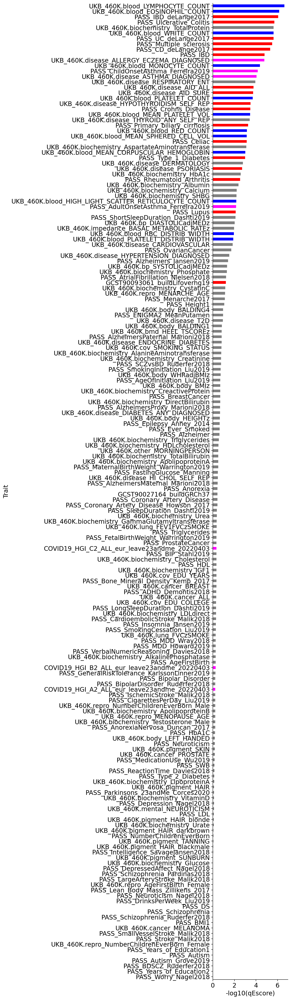

In [12]:
df_sclinker_gb.plot(y='-log10(qEscore)', x='Trait', kind='barh', color=df_sclinker_gb['color'], 
                    legend=False,figsize=(3,40))
plt.grid(None)
plt.xlabel('-log10(qEscore)')
sns.despine()

plt.savefig(str(sc.settings.figdir) + '/bar_logescore.pdf', bbox_inches='tight')

In [13]:
df_sclinker_gb.loc[df_sclinker_gb['Autoimmune'] == 1, '-log10(qEscore)']

128    1.211745
141    2.119584
147    2.530822
149    2.711632
151    2.990033
154    3.139892
157    3.279477
160    3.475977
161    3.487839
163    3.731464
164    3.778491
170    4.799570
171    5.310403
172    5.508984
173    5.628276
176    5.710631
177    6.068994
Name: -log10(qEscore), dtype: float64

In [14]:
from scipy.stats import mannwhitneyu
U1, p = mannwhitneyu(df_sclinker_gb.loc[df_sclinker_gb['Autoimmune'] == 1, '-log10(qEscore)'], 
                     df_sclinker_gb.loc[df_sclinker_gb['Autoimmune'] != 1, '-log10(qEscore)'], method="exact")
print(p)

8.507407215732066e-12


In [15]:
from scipy.stats import mannwhitneyu
U1, p = mannwhitneyu(df_sclinker_gb.loc[df_sclinker_gb['Blood'] == 1, '-log10(qEscore)'], 
                     df_sclinker_gb.loc[df_sclinker_gb['Blood'] != 1, '-log10(qEscore)'], method="exact")
print(p)

7.586692229342237e-08


In [16]:
from scipy.stats import mannwhitneyu
U1, p = mannwhitneyu(df_sclinker_gb.loc[df_sclinker_gb['Inflammatory'] == 1, '-log10(qEscore)'], 
                     df_sclinker_gb.loc[df_sclinker_gb['Inflammatory'] != 1, '-log10(qEscore)'], method="exact")
print(p)

0.13142268788105568


In [17]:
df_sclinker.loc[df_sclinker['qEscore'] < 0.05, 'Trait'].unique()

array(['PASS_AdultOnsetAsthma_Ferreira2019', 'PASS_Alzheimers_Jansen2019',
       'PASS_CD_deLange2017', 'PASS_Celiac',
       'PASS_ChildOnsetAsthma_Ferreira2019', 'PASS_Crohns_Disease',
       'PASS_IBD', 'PASS_IBD_deLange2017', 'PASS_Lupus',
       'PASS_Multiple_sclerosis', 'PASS_OvarianCancer',
       'PASS_Primary_biliary_cirrhosis', 'PASS_Rheumatoid_Arthritis',
       'PASS_ShortSleepDuration_Dashti2019', 'PASS_Type_1_Diabetes',
       'PASS_UC_deLange2017', 'PASS_Ulcerative_Colitis',
       'UKB_460K.biochemistry_Albumin',
       'UKB_460K.biochemistry_AspartateAminotransferase',
       'UKB_460K.biochemistry_Calcium', 'UKB_460K.biochemistry_HbA1c',
       'UKB_460K.biochemistry_SHBG', 'UKB_460K.biochemistry_TotalProtein',
       'UKB_460K.blood_EOSINOPHIL_COUNT',
       'UKB_460K.blood_HIGH_LIGHT_SCATTER_RETICULOCYTE_COUNT',
       'UKB_460K.blood_LYMPHOCYTE_COUNT',
       'UKB_460K.blood_MEAN_CORPUSCULAR_HEMOGLOBIN',
       'UKB_460K.blood_MEAN_PLATELET_VOL',
       'UKB_460K

In [18]:
df_metaanalysis = pd.read_csv('../output/metaanalysis/230122_CD4T_queryL2_glm_withproj.csv')
df_metaanalysis.head()

,var,Estimate,Std. Error,z value,Pr(>|z|),cell,padj
0,(Intercept),-0.527537,0.007647,-68.989295,0.000000e+00,Tnaive,0.000000e+00
1,diseaseAD,-0.311005,0.031097,-10.001192,1.505729e-23,Tnaive,1.050999e-20
2,diseaseBD,-0.092331,0.036541,-2.526776,1.151149e-02,Tnaive,1.000000e+00
3,diseaseCD,0.011020,0.053981,0.204147,8.382386e-01,Tnaive,1.000000e+00
4,diseaseCeliac,0.243248,0.069102,3.520110,4.313672e-04,Tnaive,1.854879e-01


In [19]:
df_metaanalysis['var'].unique()

array(['(Intercept)', 'diseaseAD', 'diseaseBD', 'diseaseCD',
       'diseaseCeliac', 'diseaseCovid', 'diseaseFlu', 'diseaseKawasaki',
       'diseaseMG', 'diseaseMS', 'diseaseNeurosarcoidosis',
       'diseaseParkinsonDisease', 'diseasePPP', 'diseasePsoriasis',
       'diseasepSS', 'diseaseRA', 'diseaseSarcoidosis', 'diseaseSLE',
       'diseaseT1D', 'diseaseTuberculosis', 'diseaseUC', 'age',
       'sexfemale', 'project3993994', 'project577860', 'projectCeD',
       'projectE-MTAB-10026', 'projectGSE125527', 'projectGSE132338',
       'projectGSE133028', 'projectGSE135779', 'projectGSE138266',
       'projectGSE144744', 'projectGSE149689', 'projectGSE150728',
       'projectGSE157278', 'projectGSE158055', 'projectGSE163314',
       'projectGSE168732', 'projectGSE174188', 'projectGSE181279',
       'projectGSE185857', 'projectGSE194315', 'projectGSE198616',
       'projectHRA000155', 'projectours', 'projectPRJNA605083'],
      dtype=object)

In [20]:
df_metaanalysis_nmf = pd.read_csv('../output/metaanalysis/230122_CD4T_NMF_queryL2_glm_withproj.csv')
df_metaanalysis_nmf.head()

,var,Estimate,Std. Error,t value,Pr(>|t|),cell,component,padj
0,(Intercept),0.750978,0.000247,3038.443946,0.000000e+00,Tnaive,NMF_0,0.000000e+00
1,diseaseAD,-0.003957,0.000942,-4.199530,2.674948e-05,Tnaive,NMF_0,1.147285e-01
2,diseaseBD,-0.005359,0.001177,-4.552448,5.303186e-06,Tnaive,NMF_0,2.360979e-02
3,diseaseCD,0.025480,0.001817,14.019142,1.202996e-44,Tnaive,NMF_0,7.974657e-41
4,diseaseCeliac,-0.005787,0.001915,-3.022630,2.505953e-03,Tnaive,NMF_0,1.000000e+00


## plot

In [21]:
disease = 'Multiple Sclerosis'
trait_sclinker = 'PASS_Multiple_sclerosis'
trait_meta = 'diseaseMS'

In [22]:
df_sclinker[df_sclinker['Trait'] == trait_sclinker]

,Annotations,Escore,pEscore,Trait,File,Blood,Autoimmune,Inflammatory,Brain,Neurodegenerative,qEscore,-log10(qEscore)
685,NMF0,11.876281,2.690000e-06,PASS_Multiple_sclerosis,PASS_Multiple_sclerosis.sumstats,0,1,0,0,0,0.000118,3.926720
686,NMF1,35.287336,5.420000e-05,PASS_Multiple_sclerosis,PASS_Multiple_sclerosis.sumstats,0,1,0,0,0,0.001158,2.936165
687,NMF2,9.969309,1.990000e-07,PASS_Multiple_sclerosis,PASS_Multiple_sclerosis.sumstats,0,1,0,0,0,0.000018,4.747795
688,NMF3,0.895974,3.090000e-08,PASS_Multiple_sclerosis,PASS_Multiple_sclerosis.sumstats,0,1,0,0,0,0.000005,5.310403
689,NMF4,11.126654,6.160000e-05,PASS_Multiple_sclerosis,PASS_Multiple_sclerosis.sumstats,0,1,0,0,0,0.001268,2.896816
690,NMF5,39.088395,7.041360e-04,PASS_Multiple_sclerosis,PASS_Multiple_sclerosis.sumstats,0,1,0,0,0,0.008341,2.078762
691,NMF6,0.000000,1.000000e+00,PASS_Multiple_sclerosis,PASS_Multiple_sclerosis.sumstats,0,1,0,0,0,1.000000,0.000000
692,NMF7,10.790186,3.804160e-04,PASS_Multiple_sclerosis,PASS_Multiple_sclerosis.sumstats,0,1,0,0,0,0.005010,2.300131
693,NMF8,5.882955,2.360000e-08,PASS_Multiple_sclerosis,PASS_Multiple_sclerosis.sumstats,0,1,0,0,0,0.000005,5.333770
694,NMF9,13.192340,2.230000e-05,PASS_Multiple_sclerosis,PASS_Multiple_sclerosis.sumstats,0,1,0,0,0,0.000625,3.204154


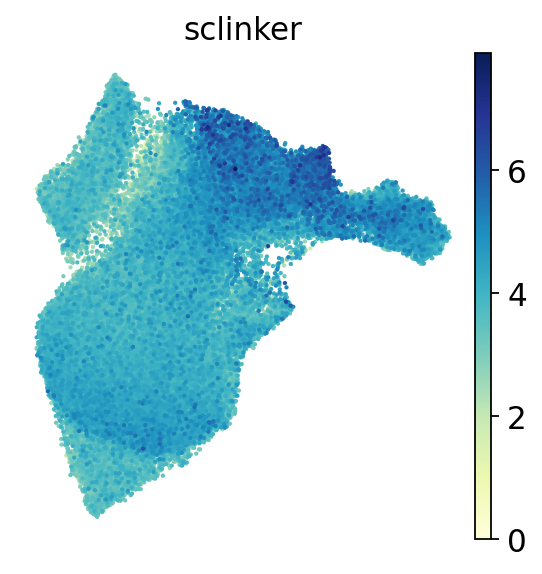

In [23]:
d = df_sclinker[df_sclinker['Trait'] == trait_sclinker]
d.index = 'NMF_' + d['Annotations'].str.split('NMF').str.get(1)

for i in range(n_comp):
    adata.obs['sclinker_NMF_{}'.format(i)] = \
    list(adata.obs['NMF_{}'.format(i)] * d.loc['NMF_{}'.format(i), '-log10(qEscore)'] / adata.obs['NMF_{}'.format(i)].max())
    
adata.obs['sclinker'] = adata.obs[['sclinker_NMF_{}'.format(i) for i in range(n_comp)]].sum(axis=1)

sc.pl.umap(adata, color=['sclinker'], cmap='YlGnBu', vmin=0, sort_order=True, s=15, save='sclinkerMS')

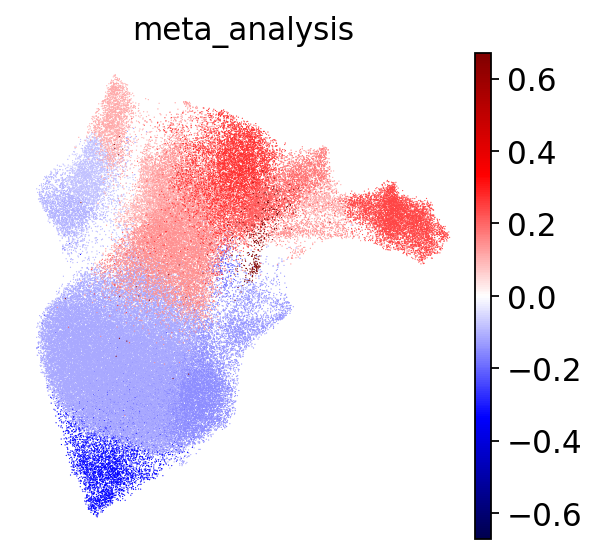

In [24]:
d = df_metaanalysis[df_metaanalysis['var'] == trait_meta]
adata.obs['meta_analysis'] = 0
for pos, row in d.iterrows():
    adata.obs.loc[adata.obs['cluster_L2_chr'] == row['cell'], 'meta_analysis'] = row['Estimate']
    
sc.pl.umap(adata, color=['meta_analysis'], cmap='seismic', 
           vmin=-adata.obs['meta_analysis'].abs().max(), 
           vmax=adata.obs['meta_analysis'].abs().max())

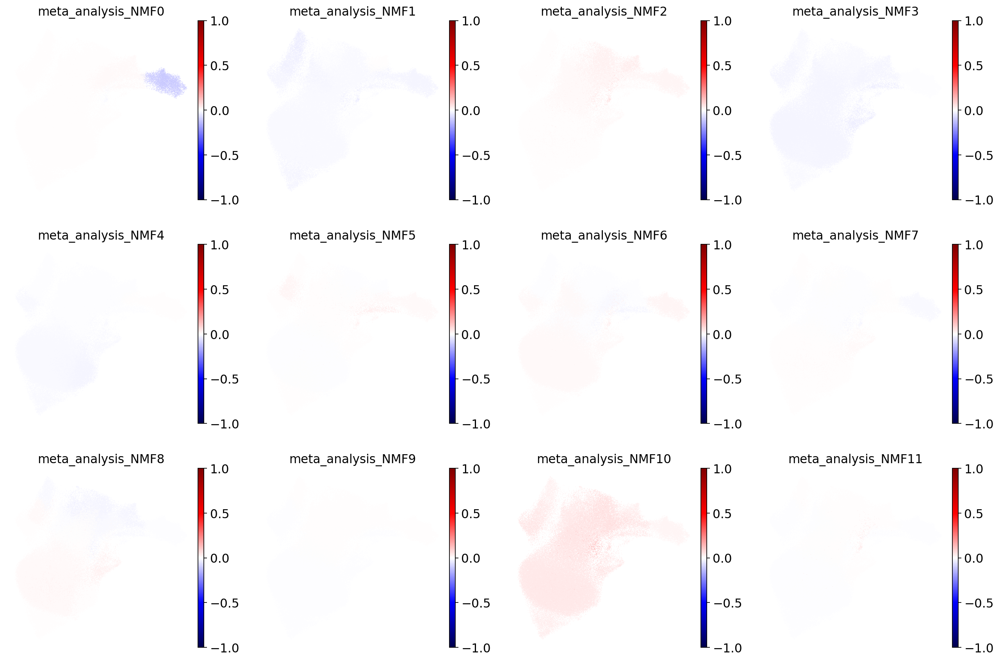

In [25]:
d = df_metaanalysis_nmf[df_metaanalysis_nmf['var'] == trait_meta]

for i in range(n_comp):
    _d = d[d['component'] == 'NMF_{}'.format(i)]
    adata.obs['meta_analysis_NMF{}'.format(i)] = 0
    for pos, row in _d.iterrows():
        adata.obs.loc[adata.obs['cluster_L2_chr'] == row['cell'], 'meta_analysis_NMF{}'.format(i)] = row['Estimate']
        
sc.pl.umap(adata, color=['meta_analysis_NMF{}'.format(i) for i in range(n_comp)], vmax=-1, vmin=1, cmap='seismic')

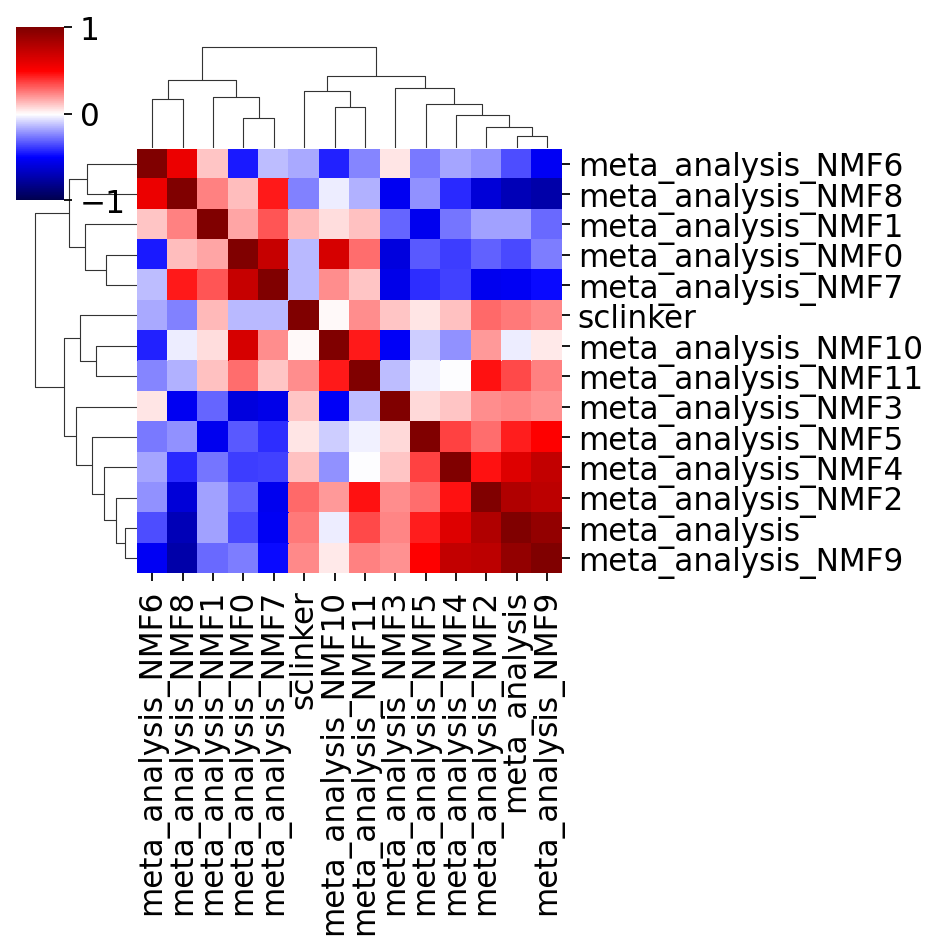

In [26]:
sns.clustermap(adata.obs[['sclinker', 'meta_analysis']+['meta_analysis_NMF{}'.format(i) for i in range(n_comp)]].corr(),
              vmin=-1, vmax=1, cmap='seismic', figsize=(6,6))
plt.savefig(str(sc.settings.figdir) + '/clu_corr_{}.pdf'.format(disease), bbox_inches='tight')

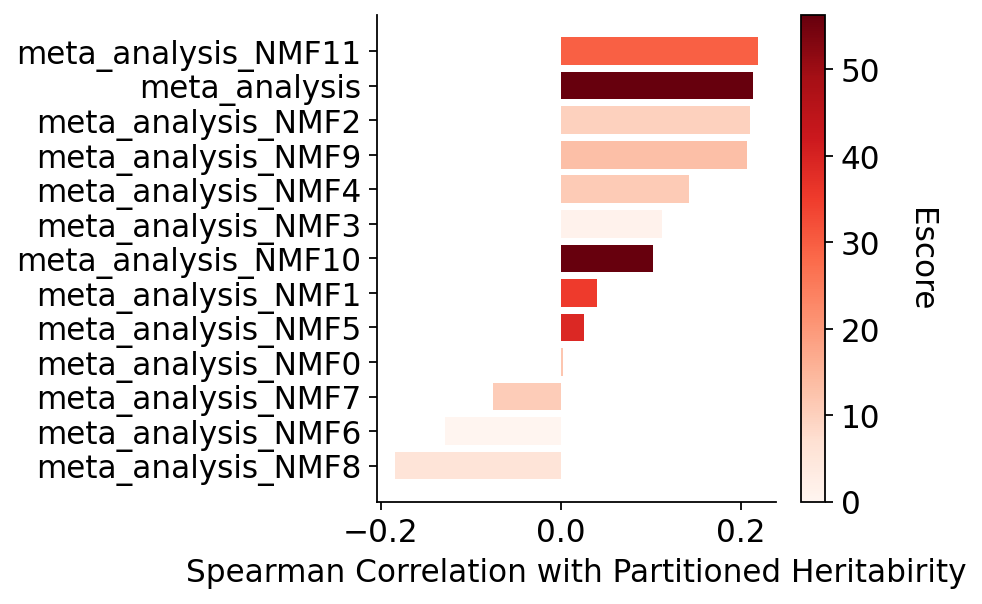

In [27]:
from matplotlib.cm import ScalarMappable

df_corr = pd.DataFrame(spearmanr(adata.obs[['sclinker', 'meta_analysis']+['meta_analysis_NMF{}'.format(i) for i in range(n_comp)]
         ])[0], columns = ['sclinker', 'meta_analysis']+['meta_analysis_NMF{}'.format(i) for i in range(n_comp)],
            index=['sclinker', 'meta_analysis']+['meta_analysis_NMF{}'.format(i) for i in range(n_comp)])
df_plot = df_corr[['sclinker']].sort_values(by='sclinker', ascending=True).iloc[:-1]
df_plot.columns = ['Correlation']
d = df_sclinker[df_sclinker['Trait'] == trait_sclinker]
df_plot['Escore'] = [d.set_index('Annotations')['Escore'].to_dict()[n.split('_')[-1]] if 'NMF' in n else d['Escore'].max() for n in df_plot.index]
df_plot['a'] = df_plot['Escore'] / df_plot['Escore'].max()
df_plot = df_plot.reset_index()

data_x = range(df_plot.shape[0])
data_hight = df_plot['Correlation']
data_color = df_plot['Escore']


data_color = [x / max(data_color) for x in data_color]
fig, ax = plt.subplots(figsize=(4, 4))

my_cmap = plt.cm.get_cmap('Reds')
colors = my_cmap(data_color)
rects = ax.barh(data_x, data_hight, color=colors)

sm = ScalarMappable(cmap=my_cmap, norm=plt.Normalize(0,max(data_color)))
sm.set_array([])

cbar = plt.colorbar(sm)
cbar.set_label('Escore', rotation=270,labelpad=25)

# ticks = np.linspace(0, df_plot['Escore'].max(), 6)
# cbar.set_ticks(ticks)

ticks = np.arange(int(df_plot.Escore.max() / 10)+1) * 10
cbar.set_ticks([x/df_plot.Escore.max() for x in ticks])
cbar.ax.set_yticklabels(ticks)
# cbar.ax.set_yticklabels([str(s) for s in ticks])

plt.yticks(data_x, df_plot['index'])
plt.xlabel("Spearman Correlation with Partitioned Heritabirity")
sns.despine()
plt.grid(None)

plt.savefig(str(sc.settings.figdir) + '/bar_corr_{}.pdf'.format(disease), bbox_inches='tight')

In [28]:
disease = 'SLE'
trait_sclinker = 'PASS_Lupus'
trait_meta = 'diseaseSLE'

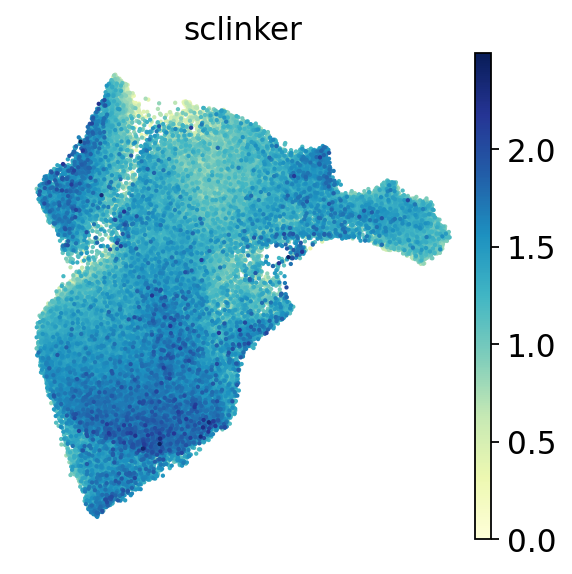

In [29]:
d = df_sclinker[df_sclinker['Trait'] == trait_sclinker]
d.index = 'NMF_' + d['Annotations'].str.split('NMF').str.get(1)

for i in range(n_comp):
    adata.obs['sclinker_NMF_{}'.format(i)] = \
    list(adata.obs['NMF_{}'.format(i)] * d.loc['NMF_{}'.format(i), '-log10(qEscore)'] / adata.obs['NMF_{}'.format(i)].max())
    
adata.obs['sclinker'] = adata.obs[['sclinker_NMF_{}'.format(i) for i in range(n_comp)]].sum(axis=1)

sc.pl.umap(adata, color=['sclinker'], cmap='YlGnBu', vmin=0, sort_order=True, s=15, save='sclinkerSLE')

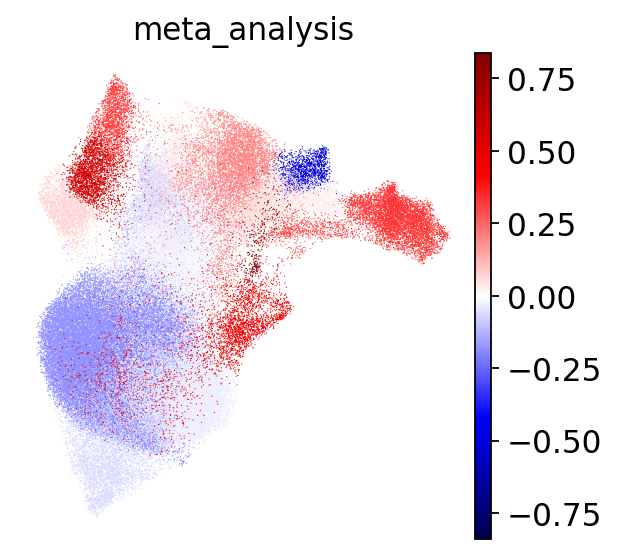

In [30]:
d = df_metaanalysis[df_metaanalysis['var'] == trait_meta]
adata.obs['meta_analysis'] = 0
for pos, row in d.iterrows():
    adata.obs.loc[adata.obs['cluster_L2_chr'] == row['cell'], 'meta_analysis'] = row['Estimate']
    
sc.pl.umap(adata, color=['meta_analysis'], cmap='seismic', 
           vmin=-adata.obs['meta_analysis'].abs().max(), 
           vmax=adata.obs['meta_analysis'].abs().max())

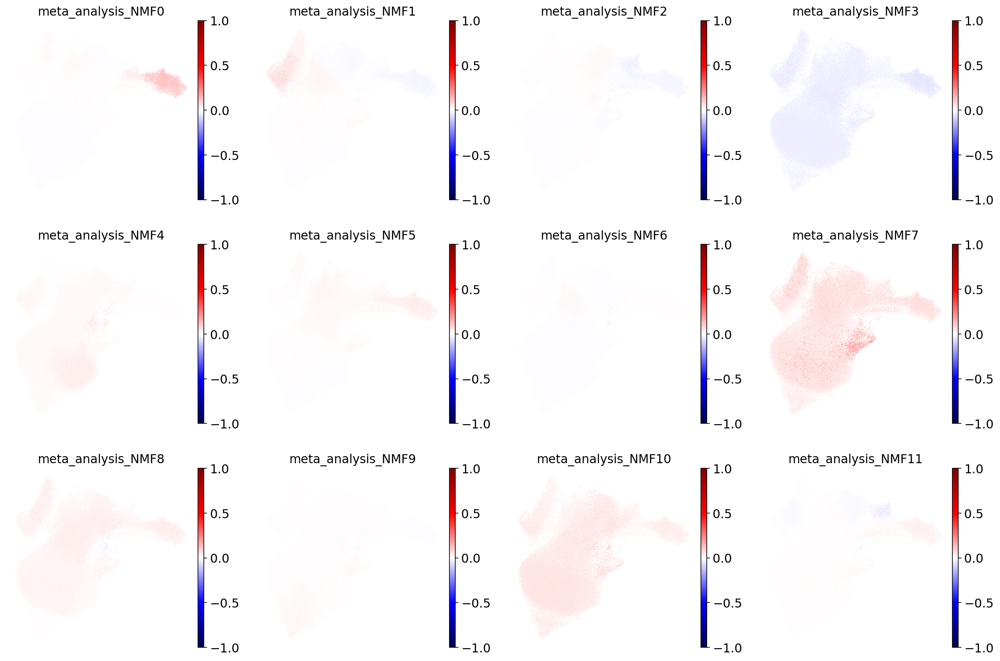

In [31]:
d = df_metaanalysis_nmf[df_metaanalysis_nmf['var'] == trait_meta]

for i in range(n_comp):
    _d = d[d['component'] == 'NMF_{}'.format(i)]
    adata.obs['meta_analysis_NMF{}'.format(i)] = 0
    for pos, row in _d.iterrows():
        adata.obs.loc[adata.obs['cluster_L2_chr'] == row['cell'], 'meta_analysis_NMF{}'.format(i)] = row['Estimate']
        
sc.pl.umap(adata, color=['meta_analysis_NMF{}'.format(i) for i in range(n_comp)], vmax=-1, vmin=1, cmap='seismic')

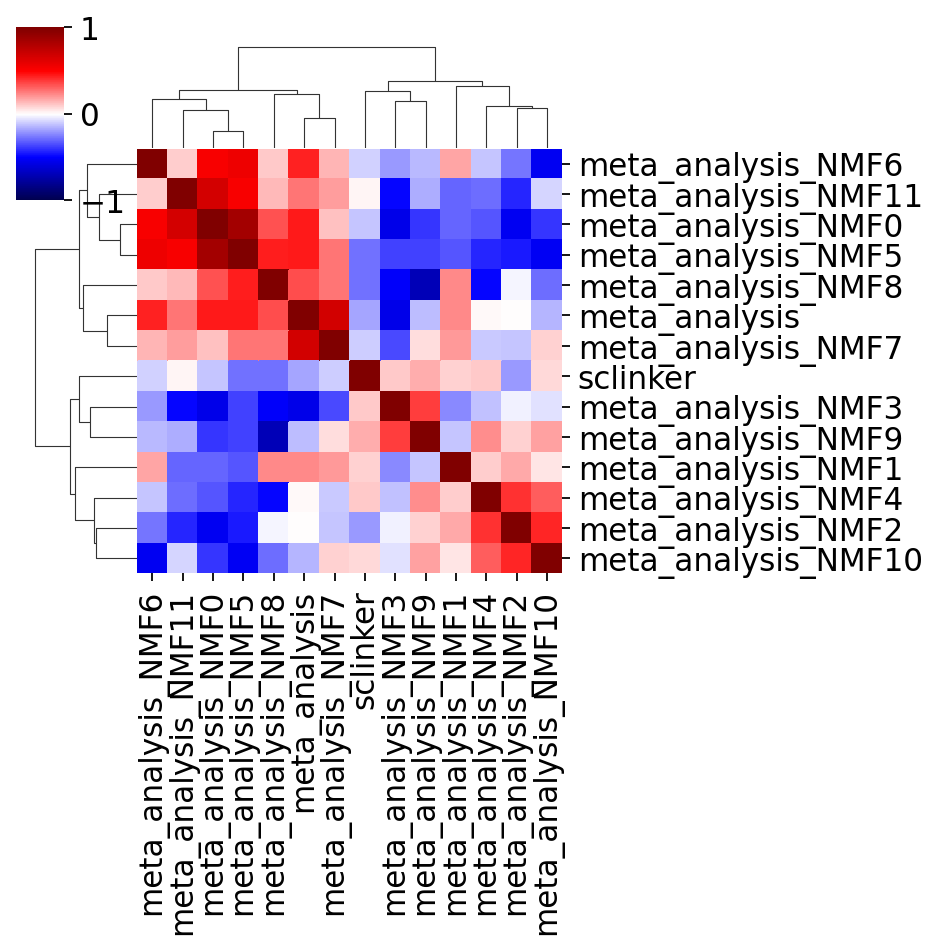

In [32]:
sns.clustermap(adata.obs[['sclinker', 'meta_analysis']+['meta_analysis_NMF{}'.format(i) for i in range(n_comp)]].corr(),
              vmin=-1, vmax=1, cmap='seismic', figsize=(6,6))

plt.savefig(str(sc.settings.figdir) + '/clu_corr_{}.pdf'.format(disease), bbox_inches='tight')

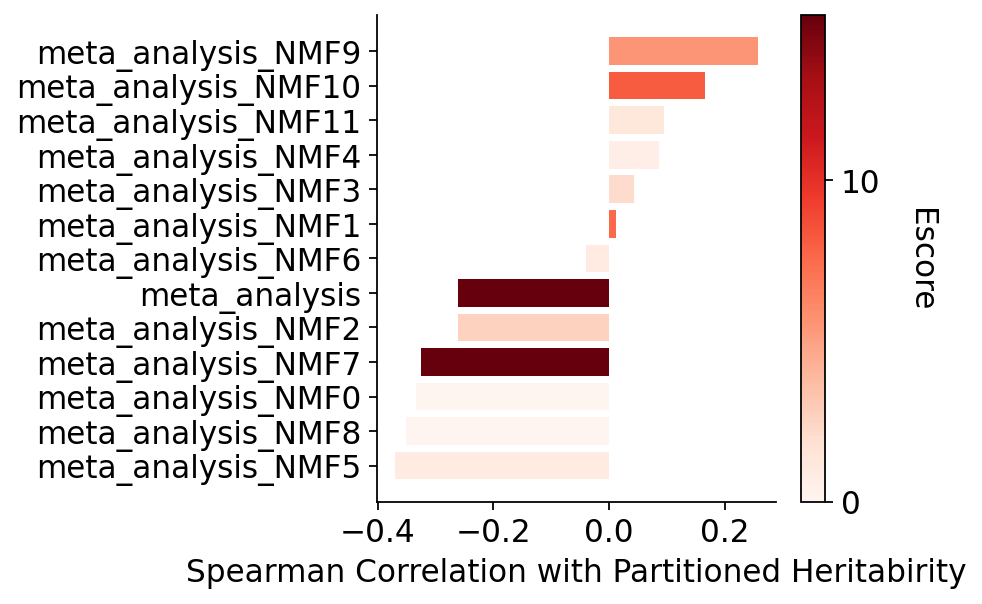

In [33]:
from matplotlib.cm import ScalarMappable

df_corr = pd.DataFrame(spearmanr(adata.obs[['sclinker', 'meta_analysis']+['meta_analysis_NMF{}'.format(i) for i in range(n_comp)]
         ])[0], columns = ['sclinker', 'meta_analysis']+['meta_analysis_NMF{}'.format(i) for i in range(n_comp)],
            index=['sclinker', 'meta_analysis']+['meta_analysis_NMF{}'.format(i) for i in range(n_comp)])
df_plot = df_corr[['sclinker']].sort_values(by='sclinker', ascending=True).iloc[:-1]
df_plot.columns = ['Correlation']
d = df_sclinker[df_sclinker['Trait'] == trait_sclinker]
df_plot['Escore'] = [d.set_index('Annotations')['Escore'].to_dict()[n.split('_')[-1]] if 'NMF' in n else d['Escore'].max() for n in df_plot.index]
df_plot['a'] = df_plot['Escore'] / df_plot['Escore'].max()
df_plot = df_plot.reset_index()

data_x = range(df_plot.shape[0])
data_hight = df_plot['Correlation']
data_color = df_plot['Escore']


data_color = [x / max(data_color) for x in data_color]
fig, ax = plt.subplots(figsize=(4, 4))

my_cmap = plt.cm.get_cmap('Reds')
colors = my_cmap(data_color)
rects = ax.barh(data_x, data_hight, color=colors)

sm = ScalarMappable(cmap=my_cmap, norm=plt.Normalize(0,max(data_color)))
sm.set_array([])

cbar = plt.colorbar(sm)
cbar.set_label('Escore', rotation=270,labelpad=25)

# ticks = np.linspace(0, df_plot['Escore'].max(), 6)
# cbar.set_ticks(ticks)

ticks = np.arange(int(df_plot.Escore.max() / 10)+1) * 10
cbar.set_ticks([x/df_plot.Escore.max() for x in ticks])
cbar.ax.set_yticklabels(ticks)
# cbar.ax.set_yticklabels([str(s) for s in ticks])

plt.yticks(data_x, df_plot['index'])
plt.xlabel("Spearman Correlation with Partitioned Heritabirity")
sns.despine()
plt.grid(None)

plt.savefig(str(sc.settings.figdir) + '/bar_corr_{}.pdf'.format(disease), bbox_inches='tight')

In [34]:
disease = 'MG'
trait_sclinker = 'GCST90093061_buildLifoverhg19'
trait_meta = 'diseaseMG'

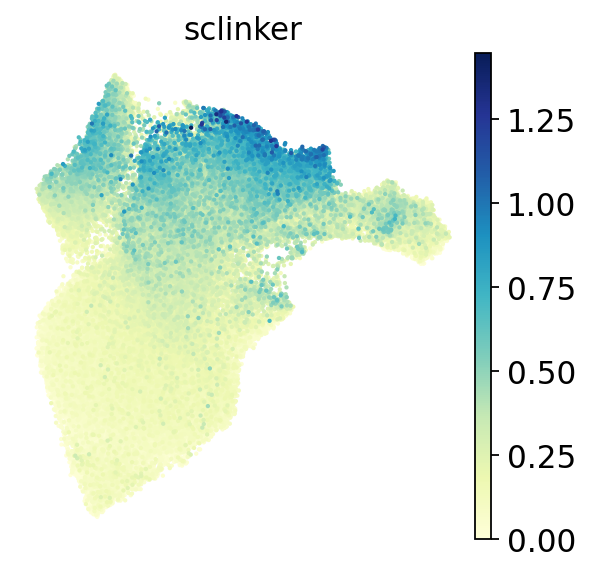

In [35]:
d = df_sclinker[df_sclinker['Trait'] == trait_sclinker]
d.index = 'NMF_' + d['Annotations'].str.split('NMF').str.get(1)

for i in range(n_comp):
    adata.obs['sclinker_NMF_{}'.format(i)] = \
    list(adata.obs['NMF_{}'.format(i)] * d.loc['NMF_{}'.format(i), '-log10(qEscore)'] / adata.obs['NMF_{}'.format(i)].max())
    
adata.obs['sclinker'] = adata.obs[['sclinker_NMF_{}'.format(i) for i in range(n_comp)]].sum(axis=1)

sc.pl.umap(adata, color=['sclinker'], cmap='YlGnBu', sort_order=True, s=15, vmin=0, save='sclinkerMG')

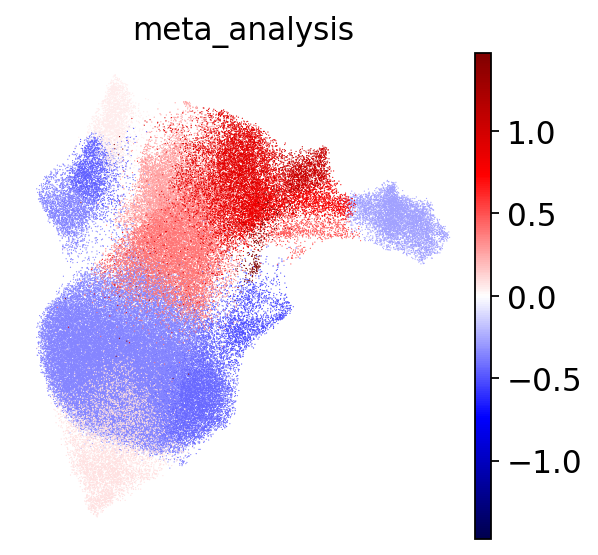

In [36]:
d = df_metaanalysis[df_metaanalysis['var'] == trait_meta]
adata.obs['meta_analysis'] = 0
for pos, row in d.iterrows():
    adata.obs.loc[adata.obs['cluster_L2_chr'] == row['cell'], 'meta_analysis'] = row['Estimate']
    
sc.pl.umap(adata, color=['meta_analysis'], cmap='seismic', 
           vmin=-adata.obs['meta_analysis'].abs().max(), 
           vmax=adata.obs['meta_analysis'].abs().max())

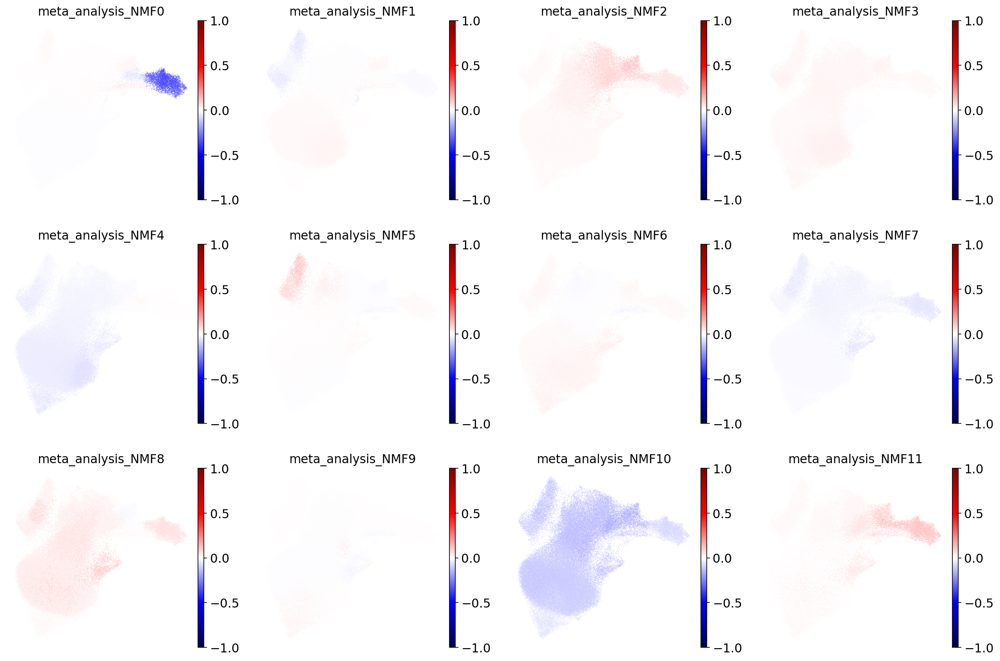

In [37]:
d = df_metaanalysis_nmf[df_metaanalysis_nmf['var'] == trait_meta]

for i in range(n_comp):
    _d = d[d['component'] == 'NMF_{}'.format(i)]
    adata.obs['meta_analysis_NMF{}'.format(i)] = 0
    for pos, row in _d.iterrows():
        adata.obs.loc[adata.obs['cluster_L2_chr'] == row['cell'], 'meta_analysis_NMF{}'.format(i)] = row['Estimate']
        
sc.pl.umap(adata, color=['meta_analysis_NMF{}'.format(i) for i in range(n_comp)], vmax=-1, vmin=1, cmap='seismic')

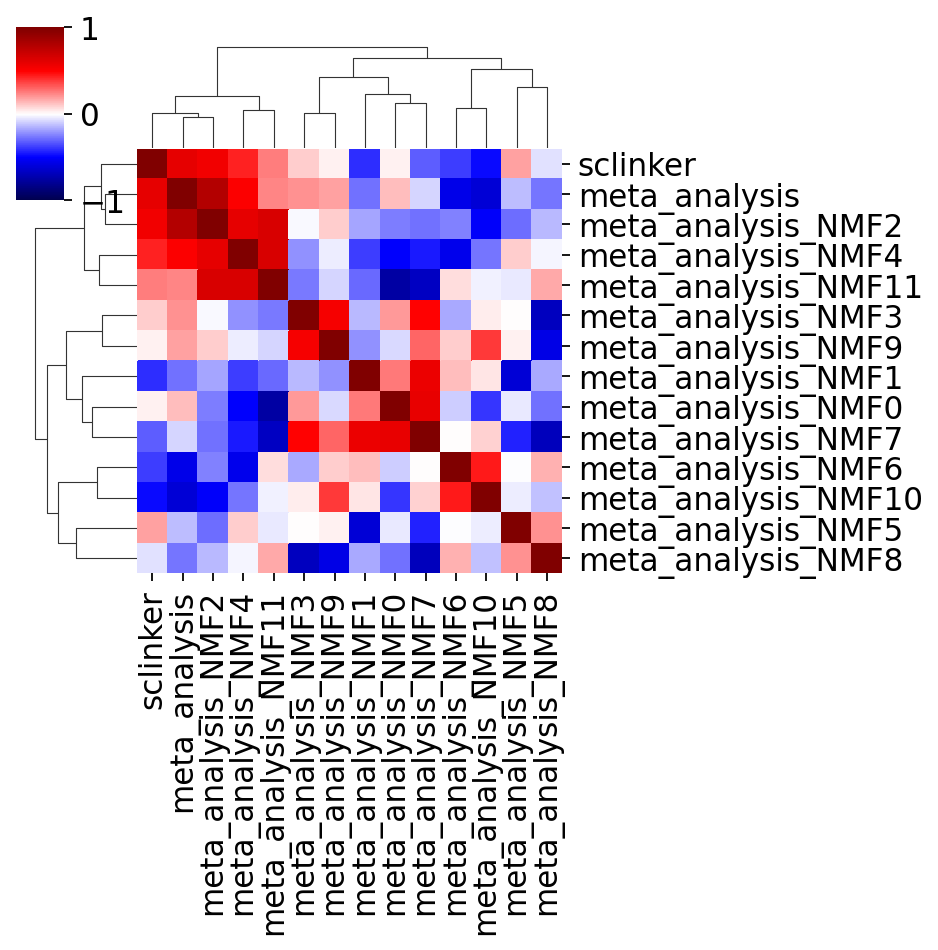

In [38]:
sns.clustermap(adata.obs[['sclinker', 'meta_analysis']+['meta_analysis_NMF{}'.format(i) for i in range(n_comp)]].corr(),
              vmin=-1, vmax=1, cmap='seismic', figsize=(6,6))
plt.savefig(str(sc.settings.figdir) + '/clu_corr_{}.pdf'.format(disease), bbox_inches='tight')

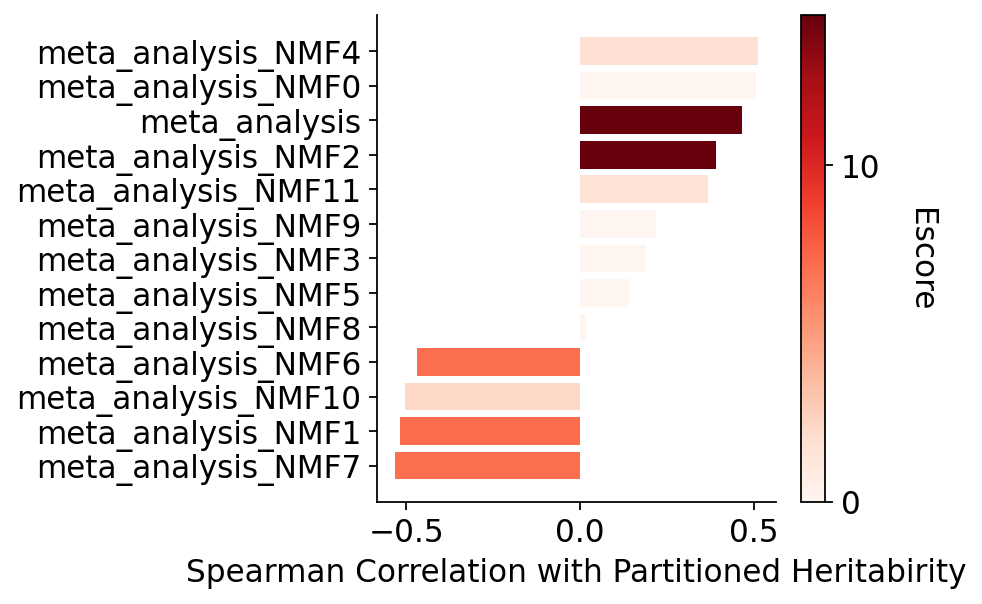

In [39]:
from matplotlib.cm import ScalarMappable

df_corr = pd.DataFrame(spearmanr(adata.obs[['sclinker', 'meta_analysis']+['meta_analysis_NMF{}'.format(i) for i in range(n_comp)]
         ])[0], columns = ['sclinker', 'meta_analysis']+['meta_analysis_NMF{}'.format(i) for i in range(n_comp)],
            index=['sclinker', 'meta_analysis']+['meta_analysis_NMF{}'.format(i) for i in range(n_comp)])
df_plot = df_corr[['sclinker']].sort_values(by='sclinker', ascending=True).iloc[:-1]
df_plot.columns = ['Correlation']
d = df_sclinker[df_sclinker['Trait'] == trait_sclinker]
df_plot['Escore'] = [d.set_index('Annotations')['Escore'].to_dict()[n.split('_')[-1]] if 'NMF' in n else d['Escore'].max() for n in df_plot.index]
df_plot['a'] = df_plot['Escore'] / df_plot['Escore'].max()
df_plot = df_plot.reset_index()

data_x = range(df_plot.shape[0])
data_hight = df_plot['Correlation']
data_color = df_plot['Escore']


data_color = [x / max(data_color) for x in data_color]
fig, ax = plt.subplots(figsize=(4, 4))

my_cmap = plt.cm.get_cmap('Reds')
colors = my_cmap(data_color)
rects = ax.barh(data_x, data_hight, color=colors)

sm = ScalarMappable(cmap=my_cmap, norm=plt.Normalize(0,max(data_color)))
sm.set_array([])

cbar = plt.colorbar(sm)
cbar.set_label('Escore', rotation=270,labelpad=25)

# ticks = np.linspace(0, df_plot['Escore'].max(), 6)
# cbar.set_ticks(ticks)

ticks = np.arange(int(df_plot.Escore.max() / 10)+1) * 10
cbar.set_ticks([x/df_plot.Escore.max() for x in ticks])
cbar.ax.set_yticklabels(ticks)
# cbar.ax.set_yticklabels([str(s) for s in ticks])

plt.yticks(data_x, df_plot['index'])
plt.xlabel("Spearman Correlation with Partitioned Heritabirity")
sns.despine()
plt.grid(None)

plt.savefig(str(sc.settings.figdir) + '/bar_corr_{}.pdf'.format(disease), bbox_inches='tight')

## corr

In [40]:
from scipy.stats import pearsonr

In [41]:
disease = 'Multiple Sclerosis'
trait_sclinker = 'PASS_Multiple_sclerosis'
trait_meta = 'diseaseMS'

In [42]:
list_pair = [['MS', 'PASS_Multiple_sclerosis', 'diseaseMS'],
             ['SLE', 'PASS_Lupus', 'diseaseSLE'], 
             ['MG', 'GCST90093061_buildLifoverhg19', 'diseaseMG'],
             ['RA', 'PASS_Rheumatoid_Arthritis', 'diseaseRA'],
             ['COVID19-A', 'COVID19_HGI_A2_ALL_eur_leave23andme_20220403', 'diseaseCovid'],
             ['COVID19-B', 'COVID19_HGI_B2_ALL_eur_leave23andme_20220403', 'diseaseCovid'],
             ['COVID19-C', 'COVID19_HGI_C2_ALL_eur_leave23andme_20220403', 'diseaseCovid'],
             ['CD deLange2017', 'PASS_CD_deLange2017', 'diseaseCD'],
             ['Celiac', 'PASS_Celiac', 'diseaseCeliac'],
             ['Psoriasis', 'UKB_460K.disease_PSORIASIS', 'diseasePsoriasis'],
             ['UC', 'PASS_UC_deLange2017', 'diseaseUC']
            ]

In [47]:
list_stats_corr = []

for p in list_pair:
    disease = p[0]
    trait_sclinker = p[1]
    trait_meta = p[2]
    d = df_sclinker[df_sclinker['Trait'] == trait_sclinker]
    d.index = 'NMF_' + d['Annotations'].str.split('NMF').str.get(1)

    for i in range(n_comp):
        adata.obs['sclinker_NMF_{}'.format(i)] = \
        list(adata.obs['NMF_{}'.format(i)] * d.loc['NMF_{}'.format(i), '-log10(qEscore)'] / adata.obs['NMF_{}'.format(i)].max())

    adata.obs['sclinker'] = adata.obs[['sclinker_NMF_{}'.format(i) for i in range(n_comp)]].sum(axis=1)

    d = df_metaanalysis[df_metaanalysis['var'] == trait_meta]
    adata.obs['meta_analysis'] = 0
    for pos, row in d.iterrows():
        adata.obs.loc[adata.obs['cluster_L2_chr'] == row['cell'], 'meta_analysis'] = row['Estimate']

    d = df_metaanalysis_nmf[df_metaanalysis_nmf['var'] == trait_meta]

    for i in range(n_comp):
        _d = d[d['component'] == 'NMF_{}'.format(i)]
        adata.obs['meta_analysis_NMF{}'.format(i)] = 0
        for pos, row in _d.iterrows():
            adata.obs.loc[adata.obs['cluster_L2_chr'] == row['cell'], 'meta_analysis_NMF{}'.format(i)] = row['Estimate']

    rm,pm = spearmanr(adata.obs['sclinker'], adata.obs['meta_analysis'])

    top_corr = adata.obs[['sclinker'] + ['meta_analysis_NMF{}'.format(i) for i in range(n_comp)
                             ]].corr()['sclinker'].sort_values(ascending=False).index[1]

    rn,pn = spearmanr(adata.obs['sclinker'], adata.obs[top_corr])

    list_stats_corr.append([disease, rm, pm, rn, pn, top_corr])

In [48]:
df_stats_corr = pd.DataFrame(list_stats_corr,
             columns=['disease', 'R_sclinker_meta', 'p_sclinker_meta', 
                      'R_sclinker_metaNMF', 'p_sclinker_metaNMF', 'top_correlated_comp'])
df_stats_corr.to_csv(str(sc.settings.figdir) + '/corr_aid.csv')
df_stats_corr

,disease,R_sclinker_meta,p_sclinker_meta,R_sclinker_metaNMF,p_sclinker_metaNMF,top_correlated_comp
0,MS,0.213600,0.000000e+00,0.210881,0.000000e+00,meta_analysis_NMF2
1,SLE,-0.260751,0.000000e+00,0.257245,0.000000e+00,meta_analysis_NMF9
2,MG,0.465283,0.000000e+00,0.392346,0.000000e+00,meta_analysis_NMF2
3,RA,0.097798,1.372677e-217,0.421880,0.000000e+00,meta_analysis_NMF3
4,COVID19-A,-0.291168,0.000000e+00,0.487185,0.000000e+00,meta_analysis_NMF7
5,COVID19-B,-0.328882,0.000000e+00,0.526461,0.000000e+00,meta_analysis_NMF7
6,COVID19-C,-0.008497,6.351217e-03,0.109518,1.180694e-272,meta_analysis_NMF7
7,CD deLange2017,0.178724,0.000000e+00,0.079982,5.528858e-146,meta_analysis_NMF0
8,CD,0.093703,7.668983e-200,0.337447,0.000000e+00,meta_analysis_NMF5
9,Celiac,-0.360990,0.000000e+00,0.180213,0.000000e+00,meta_analysis_NMF3


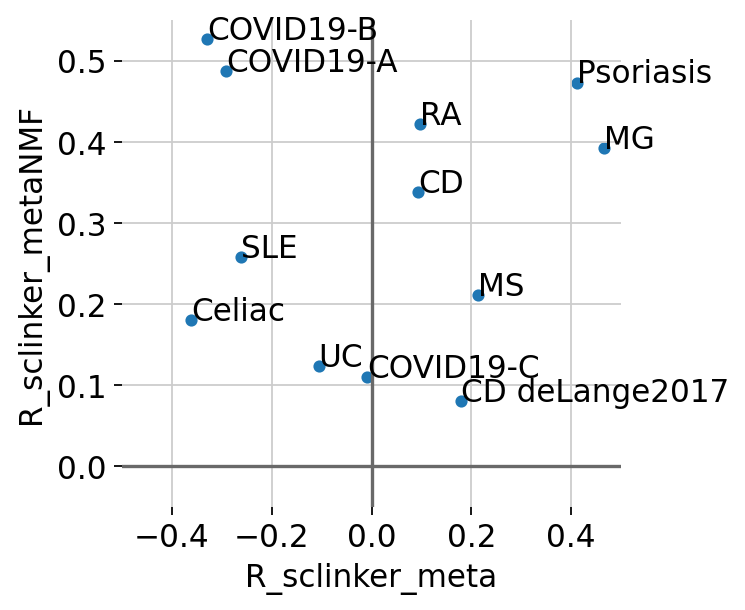

In [49]:
df_stats_corr.plot.scatter(x='R_sclinker_meta', y='R_sclinker_metaNMF')
for pos,row in df_stats_corr.iterrows():
    plt.text(row['R_sclinker_meta'], row['R_sclinker_metaNMF'], row['disease'])
sns.despine(top=True, right=True, left=True, bottom=True)

plt.xlim(-0.5, 0.5)
plt.ylim(-0.05, 0.55)
plt.hlines(0, -1, 1, color='dimgrey')
plt.vlines(0, -1, 1, color='dimgrey')

plt.savefig(str(sc.settings.figdir) + '/corr_aid.pdf', bbox_inches='tight')

## plot all

In [43]:
for trait_sclinker in tqdm(df_sclinker.Trait.unique()):
    d = df_sclinker[df_sclinker['Trait'] == trait_sclinker]
    d.index = 'NMF_' + d['Annotations'].str.split('NMF').str.get(1)

    for i in range(n_comp):
        adata.obs['sclinker_NMF_{}'.format(i)] = \
        list(adata.obs['NMF_{}'.format(i)] * d.loc['NMF_{}'.format(i), '-log10(qEscore)'] / adata.obs['NMF_{}'.format(i)].max())

    adata.obs['sclinker'] = adata.obs[['sclinker_NMF_{}'.format(i) for i in range(n_comp)]].sum(axis=1)

    sc.pl.umap(adata, color=['sclinker'], cmap='YlGnBu', vmin=0, vmax=max(1, adata.obs['sclinker'].max()),
           save='sclinker_{}'.format(trait_sclinker),
           title="sclinker {}".format(trait_sclinker), sort_order=True, s=15, show=False)

  0%|                                                                                                                                                        | 0/180 [00:00<?, ?it/s]

  1%|▊                                                                                                                                               | 1/180 [00:01<03:43,  1.25s/it]

  1%|█▌                                                                                                                                              | 2/180 [00:02<03:38,  1.23s/it]

  2%|██▍                                                                                                                                             | 3/180 [00:03<03:36,  1.22s/it]

  2%|███▏                                                                                                                                            | 4/180 [00:04<03:33,  1.21s/it]

  3%|████                                                                                                                                            | 5/180 [00:06<03:32,  1.21s/it]

  3%|████▊                                                                                                                                           | 6/180 [00:07<03:30,  1.21s/it]

  4%|█████▌                                                                                                                                          | 7/180 [00:08<03:29,  1.21s/it]

  4%|██████▍                                                                                                                                         | 8/180 [00:10<03:48,  1.33s/it]

  5%|███████▏                                                                                                                                        | 9/180 [00:11<03:46,  1.33s/it]

  6%|███████▉                                                                                                                                       | 10/180 [00:12<03:42,  1.31s/it]

  6%|████████▋                                                                                                                                      | 11/180 [00:13<03:38,  1.29s/it]

  7%|█████████▌                                                                                                                                     | 12/180 [00:15<03:33,  1.27s/it]

  7%|██████████▎                                                                                                                                    | 13/180 [00:16<03:34,  1.28s/it]

  8%|███████████                                                                                                                                    | 14/180 [00:17<03:26,  1.25s/it]

  8%|███████████▉                                                                                                                                   | 15/180 [00:18<03:21,  1.22s/it]

  9%|████████████▋                                                                                                                                  | 16/180 [00:19<03:18,  1.21s/it]

  9%|█████████████▌                                                                                                                                 | 17/180 [00:21<03:16,  1.21s/it]

 10%|██████████████▎                                                                                                                                | 18/180 [00:22<03:14,  1.20s/it]

 11%|███████████████                                                                                                                                | 19/180 [00:23<03:18,  1.23s/it]

 11%|███████████████▉                                                                                                                               | 20/180 [00:24<03:15,  1.22s/it]

 12%|████████████████▋                                                                                                                              | 21/180 [00:26<03:13,  1.22s/it]

 12%|█████████████████▍                                                                                                                             | 22/180 [00:27<03:11,  1.21s/it]

 13%|██████████████████▎                                                                                                                            | 23/180 [00:28<03:09,  1.20s/it]

 13%|███████████████████                                                                                                                            | 24/180 [00:29<03:06,  1.20s/it]

 14%|███████████████████▊                                                                                                                           | 25/180 [00:30<03:07,  1.21s/it]

 14%|████████████████████▋                                                                                                                          | 26/180 [00:32<03:07,  1.22s/it]

 15%|█████████████████████▍                                                                                                                         | 27/180 [00:33<03:07,  1.23s/it]

 16%|██████████████████████▏                                                                                                                        | 28/180 [00:34<03:04,  1.21s/it]

 16%|███████████████████████                                                                                                                        | 29/180 [00:35<03:01,  1.21s/it]

 17%|███████████████████████▊                                                                                                                       | 30/180 [00:37<03:11,  1.27s/it]

 17%|████████████████████████▋                                                                                                                      | 31/180 [00:38<03:05,  1.24s/it]

 18%|█████████████████████████▍                                                                                                                     | 32/180 [00:39<03:05,  1.25s/it]

 18%|██████████████████████████▏                                                                                                                    | 33/180 [00:40<03:05,  1.26s/it]

 19%|███████████████████████████                                                                                                                    | 34/180 [00:42<03:04,  1.26s/it]

 19%|███████████████████████████▊                                                                                                                   | 35/180 [00:43<03:02,  1.26s/it]

 20%|████████████████████████████▌                                                                                                                  | 36/180 [00:44<02:58,  1.24s/it]

 21%|█████████████████████████████▍                                                                                                                 | 37/180 [00:45<02:55,  1.23s/it]

 21%|██████████████████████████████▏                                                                                                                | 38/180 [00:47<02:53,  1.22s/it]

 22%|██████████████████████████████▉                                                                                                                | 39/180 [00:48<02:51,  1.22s/it]

 22%|███████████████████████████████▊                                                                                                               | 40/180 [00:49<02:49,  1.21s/it]

 23%|████████████████████████████████▌                                                                                                              | 41/180 [00:50<02:48,  1.21s/it]

 23%|█████████████████████████████████▎                                                                                                             | 42/180 [00:51<02:46,  1.21s/it]

 24%|██████████████████████████████████▏                                                                                                            | 43/180 [00:53<02:48,  1.23s/it]

 24%|██████████████████████████████████▉                                                                                                            | 44/180 [00:54<02:48,  1.24s/it]

 25%|███████████████████████████████████▊                                                                                                           | 45/180 [00:55<02:48,  1.25s/it]

 26%|████████████████████████████████████▌                                                                                                          | 46/180 [00:56<02:47,  1.25s/it]

 26%|█████████████████████████████████████▎                                                                                                         | 47/180 [00:58<02:48,  1.27s/it]

 27%|██████████████████████████████████████▏                                                                                                        | 48/180 [00:59<02:47,  1.27s/it]

 27%|██████████████████████████████████████▉                                                                                                        | 49/180 [01:00<02:44,  1.25s/it]

 28%|███████████████████████████████████████▋                                                                                                       | 50/180 [01:01<02:39,  1.23s/it]

 28%|████████████████████████████████████████▌                                                                                                      | 51/180 [01:03<02:40,  1.25s/it]

 29%|█████████████████████████████████████████▎                                                                                                     | 52/180 [01:04<02:40,  1.26s/it]

 29%|██████████████████████████████████████████                                                                                                     | 53/180 [01:05<02:39,  1.26s/it]

 30%|██████████████████████████████████████████▉                                                                                                    | 54/180 [01:06<02:36,  1.24s/it]

 31%|███████████████████████████████████████████▋                                                                                                   | 55/180 [01:08<02:48,  1.35s/it]

 31%|████████████████████████████████████████████▍                                                                                                  | 56/180 [01:09<02:42,  1.31s/it]

 32%|█████████████████████████████████████████████▎                                                                                                 | 57/180 [01:10<02:39,  1.30s/it]

 32%|██████████████████████████████████████████████                                                                                                 | 58/180 [01:12<02:34,  1.27s/it]

 33%|██████████████████████████████████████████████▊                                                                                                | 59/180 [01:13<02:34,  1.28s/it]

 33%|███████████████████████████████████████████████▋                                                                                               | 60/180 [01:14<02:32,  1.27s/it]

 34%|████████████████████████████████████████████████▍                                                                                              | 61/180 [01:15<02:30,  1.27s/it]

 34%|█████████████████████████████████████████████████▎                                                                                             | 62/180 [01:17<02:28,  1.26s/it]

 35%|██████████████████████████████████████████████████                                                                                             | 63/180 [01:18<02:24,  1.24s/it]

 36%|██████████████████████████████████████████████████▊                                                                                            | 64/180 [01:19<02:23,  1.24s/it]

 36%|███████████████████████████████████████████████████▋                                                                                           | 65/180 [01:20<02:22,  1.24s/it]

 37%|████████████████████████████████████████████████████▍                                                                                          | 66/180 [01:22<02:19,  1.23s/it]

 37%|█████████████████████████████████████████████████████▏                                                                                         | 67/180 [01:23<02:18,  1.23s/it]

 38%|██████████████████████████████████████████████████████                                                                                         | 68/180 [01:24<02:17,  1.23s/it]

 38%|██████████████████████████████████████████████████████▊                                                                                        | 69/180 [01:25<02:15,  1.22s/it]

 39%|███████████████████████████████████████████████████████▌                                                                                       | 70/180 [01:27<02:15,  1.23s/it]

 39%|████████████████████████████████████████████████████████▍                                                                                      | 71/180 [01:28<02:12,  1.21s/it]

 40%|█████████████████████████████████████████████████████████▏                                                                                     | 72/180 [01:29<02:09,  1.20s/it]

 41%|█████████████████████████████████████████████████████████▉                                                                                     | 73/180 [01:30<02:12,  1.24s/it]

 41%|██████████████████████████████████████████████████████████▊                                                                                    | 74/180 [01:31<02:11,  1.24s/it]

 42%|███████████████████████████████████████████████████████████▌                                                                                   | 75/180 [01:33<02:10,  1.24s/it]

 42%|████████████████████████████████████████████████████████████▍                                                                                  | 76/180 [01:34<02:07,  1.23s/it]

 43%|█████████████████████████████████████████████████████████████▏                                                                                 | 77/180 [01:35<02:08,  1.24s/it]

 43%|█████████████████████████████████████████████████████████████▉                                                                                 | 78/180 [01:36<02:04,  1.22s/it]

 44%|██████████████████████████████████████████████████████████████▊                                                                                | 79/180 [01:38<02:02,  1.21s/it]

 44%|███████████████████████████████████████████████████████████████▌                                                                               | 80/180 [01:39<02:04,  1.24s/it]

 45%|████████████████████████████████████████████████████████████████▎                                                                              | 81/180 [01:40<02:03,  1.25s/it]

 46%|█████████████████████████████████████████████████████████████████▏                                                                             | 82/180 [01:41<02:02,  1.25s/it]

 46%|█████████████████████████████████████████████████████████████████▉                                                                             | 83/180 [01:43<02:01,  1.26s/it]

 47%|██████████████████████████████████████████████████████████████████▋                                                                            | 84/180 [01:44<02:10,  1.36s/it]

 47%|███████████████████████████████████████████████████████████████████▌                                                                           | 85/180 [01:45<02:03,  1.30s/it]

 48%|████████████████████████████████████████████████████████████████████▎                                                                          | 86/180 [01:47<02:01,  1.29s/it]

 48%|█████████████████████████████████████████████████████████████████████                                                                          | 87/180 [01:48<01:58,  1.28s/it]

 49%|█████████████████████████████████████████████████████████████████████▉                                                                         | 88/180 [01:49<01:56,  1.26s/it]

 49%|██████████████████████████████████████████████████████████████████████▋                                                                        | 89/180 [01:50<01:53,  1.25s/it]

 50%|███████████████████████████████████████████████████████████████████████▌                                                                       | 90/180 [01:52<01:50,  1.23s/it]

 51%|████████████████████████████████████████████████████████████████████████▎                                                                      | 91/180 [01:53<01:49,  1.23s/it]

 51%|█████████████████████████████████████████████████████████████████████████                                                                      | 92/180 [01:54<01:47,  1.22s/it]

 52%|█████████████████████████████████████████████████████████████████████████▉                                                                     | 93/180 [01:55<01:48,  1.25s/it]

 52%|██████████████████████████████████████████████████████████████████████████▋                                                                    | 94/180 [01:57<01:48,  1.26s/it]

 53%|███████████████████████████████████████████████████████████████████████████▍                                                                   | 95/180 [01:58<01:47,  1.26s/it]

 53%|████████████████████████████████████████████████████████████████████████████▎                                                                  | 96/180 [01:59<01:45,  1.25s/it]

 54%|█████████████████████████████████████████████████████████████████████████████                                                                  | 97/180 [02:00<01:44,  1.25s/it]

 54%|█████████████████████████████████████████████████████████████████████████████▊                                                                 | 98/180 [02:02<01:43,  1.26s/it]

 55%|██████████████████████████████████████████████████████████████████████████████▋                                                                | 99/180 [02:03<01:42,  1.27s/it]

 56%|██████████████████████████████████████████████████████████████████████████████▉                                                               | 100/180 [02:04<01:42,  1.28s/it]

 56%|███████████████████████████████████████████████████████████████████████████████▋                                                              | 101/180 [02:05<01:40,  1.27s/it]

 57%|████████████████████████████████████████████████████████████████████████████████▍                                                             | 102/180 [02:07<01:40,  1.28s/it]

 57%|█████████████████████████████████████████████████████████████████████████████████▎                                                            | 103/180 [02:08<01:38,  1.28s/it]

 58%|██████████████████████████████████████████████████████████████████████████████████                                                            | 104/180 [02:09<01:37,  1.28s/it]

 58%|██████████████████████████████████████████████████████████████████████████████████▊                                                           | 105/180 [02:11<01:34,  1.26s/it]

 59%|███████████████████████████████████████████████████████████████████████████████████▌                                                          | 106/180 [02:12<01:31,  1.24s/it]

 59%|████████████████████████████████████████████████████████████████████████████████████▍                                                         | 107/180 [02:13<01:30,  1.24s/it]

 60%|█████████████████████████████████████████████████████████████████████████████████████▏                                                        | 108/180 [02:14<01:29,  1.24s/it]

 61%|█████████████████████████████████████████████████████████████████████████████████████▉                                                        | 109/180 [02:15<01:27,  1.23s/it]

 61%|██████████████████████████████████████████████████████████████████████████████████████▊                                                       | 110/180 [02:17<01:26,  1.23s/it]

 62%|███████████████████████████████████████████████████████████████████████████████████████▌                                                      | 111/180 [02:18<01:24,  1.22s/it]

 62%|████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 112/180 [02:19<01:23,  1.23s/it]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 113/180 [02:20<01:23,  1.24s/it]

 63%|█████████████████████████████████████████████████████████████████████████████████████████▉                                                    | 114/180 [02:22<01:22,  1.26s/it]

 64%|██████████████████████████████████████████████████████████████████████████████████████████▋                                                   | 115/180 [02:23<01:22,  1.26s/it]

 64%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 116/180 [02:24<01:19,  1.25s/it]

 65%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 117/180 [02:25<01:17,  1.23s/it]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████                                                 | 118/180 [02:27<01:24,  1.37s/it]

 66%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 119/180 [02:28<01:21,  1.33s/it]

 67%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 120/180 [02:29<01:17,  1.29s/it]

 67%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 121/180 [02:31<01:15,  1.28s/it]

 68%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 122/180 [02:32<01:14,  1.28s/it]

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████                                             | 123/180 [02:33<01:14,  1.31s/it]

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 124/180 [02:35<01:12,  1.30s/it]

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 125/180 [02:36<01:09,  1.26s/it]

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                          | 126/180 [02:37<01:08,  1.27s/it]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                         | 127/180 [02:38<01:08,  1.28s/it]

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 128/180 [02:40<01:06,  1.28s/it]

 72%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                        | 129/180 [02:41<01:05,  1.28s/it]

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                       | 130/180 [02:42<01:03,  1.26s/it]

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                      | 131/180 [02:43<01:00,  1.24s/it]

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 132/180 [02:45<00:59,  1.25s/it]

 74%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 133/180 [02:46<00:57,  1.23s/it]

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                    | 134/180 [02:47<00:57,  1.26s/it]

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 135/180 [02:48<00:57,  1.27s/it]

 76%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 136/180 [02:50<00:56,  1.27s/it]

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 137/180 [02:51<00:54,  1.26s/it]

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 138/180 [02:52<00:52,  1.25s/it]

 77%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 139/180 [02:53<00:50,  1.23s/it]

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 140/180 [02:55<00:48,  1.22s/it]

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 141/180 [02:56<00:47,  1.21s/it]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                              | 142/180 [02:57<00:47,  1.26s/it]

 79%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 143/180 [02:58<00:46,  1.26s/it]

 80%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 144/180 [03:00<00:44,  1.24s/it]

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 145/180 [03:01<00:43,  1.25s/it]

 81%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                          | 146/180 [03:02<00:42,  1.24s/it]

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                          | 147/180 [03:03<00:40,  1.23s/it]

 82%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 148/180 [03:05<00:39,  1.23s/it]

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 149/180 [03:06<00:37,  1.22s/it]

 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 150/180 [03:07<00:37,  1.25s/it]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 151/180 [03:08<00:36,  1.24s/it]

 84%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 152/180 [03:09<00:34,  1.23s/it]

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 153/180 [03:11<00:32,  1.22s/it]

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 154/180 [03:12<00:32,  1.24s/it]

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 155/180 [03:13<00:31,  1.26s/it]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 156/180 [03:15<00:30,  1.26s/it]

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 157/180 [03:16<00:32,  1.41s/it]

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 158/180 [03:17<00:29,  1.35s/it]

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 159/180 [03:19<00:27,  1.30s/it]

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 160/180 [03:20<00:25,  1.28s/it]

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 161/180 [03:21<00:23,  1.26s/it]

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 162/180 [03:22<00:22,  1.24s/it]

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 163/180 [03:23<00:20,  1.23s/it]

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 164/180 [03:25<00:19,  1.22s/it]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 165/180 [03:26<00:18,  1.21s/it]

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 166/180 [03:27<00:17,  1.23s/it]

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 167/180 [03:28<00:16,  1.25s/it]

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 168/180 [03:30<00:14,  1.24s/it]

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 169/180 [03:31<00:13,  1.23s/it]

 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 170/180 [03:32<00:12,  1.23s/it]

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 171/180 [03:33<00:10,  1.22s/it]

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 172/180 [03:34<00:09,  1.21s/it]

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 173/180 [03:36<00:08,  1.21s/it]

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 174/180 [03:37<00:07,  1.20s/it]

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 175/180 [03:38<00:05,  1.19s/it]

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 176/180 [03:39<00:04,  1.21s/it]

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 177/180 [03:41<00:03,  1.23s/it]

 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 178/180 [03:42<00:02,  1.22s/it]

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 179/180 [03:43<00:01,  1.22s/it]

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 180/180 [03:44<00:00,  1.25s/it]


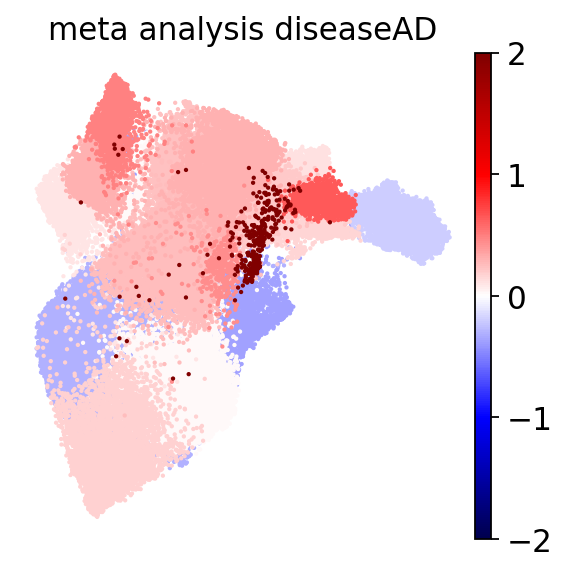

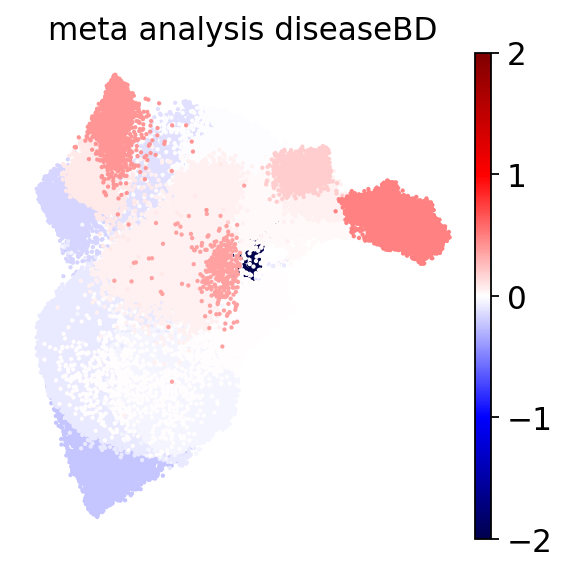

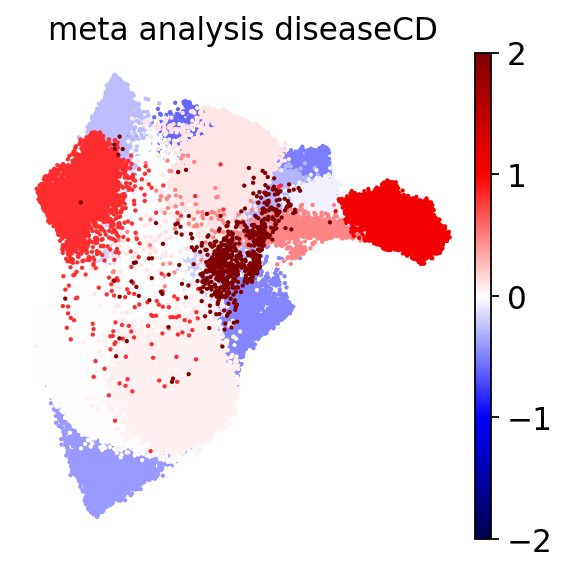

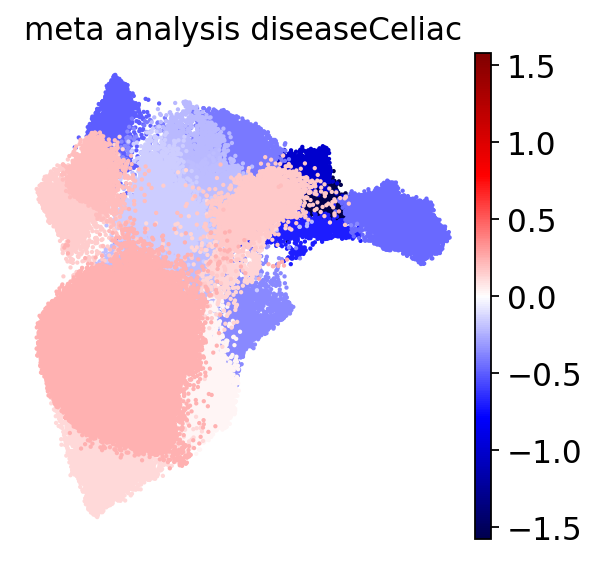

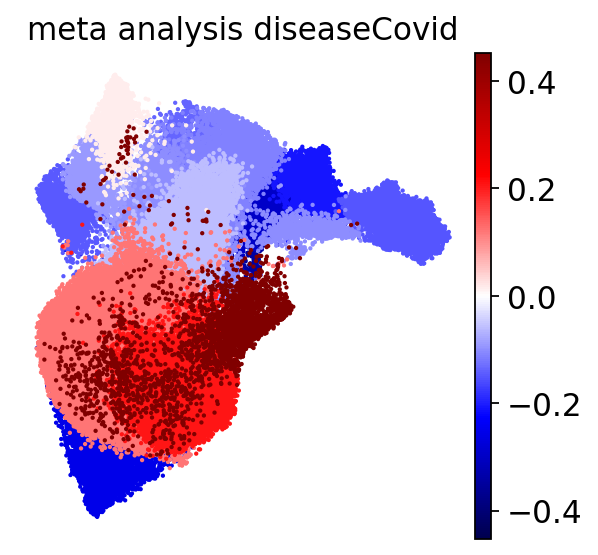

...

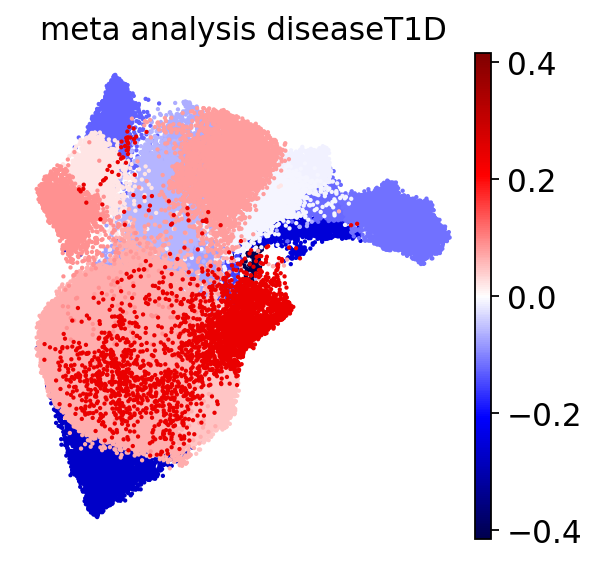

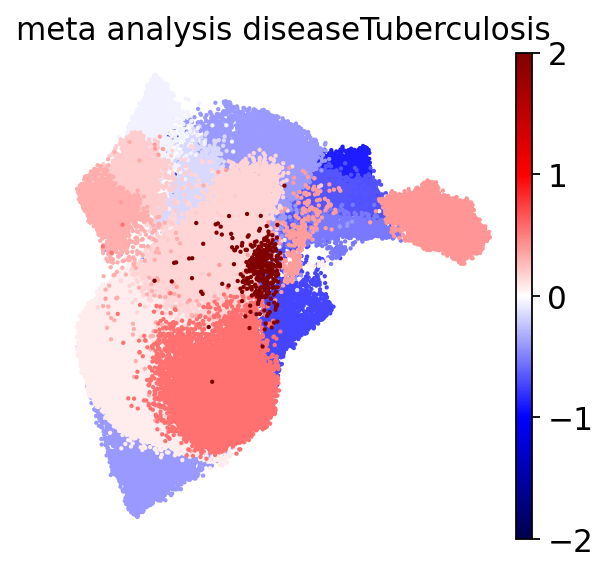

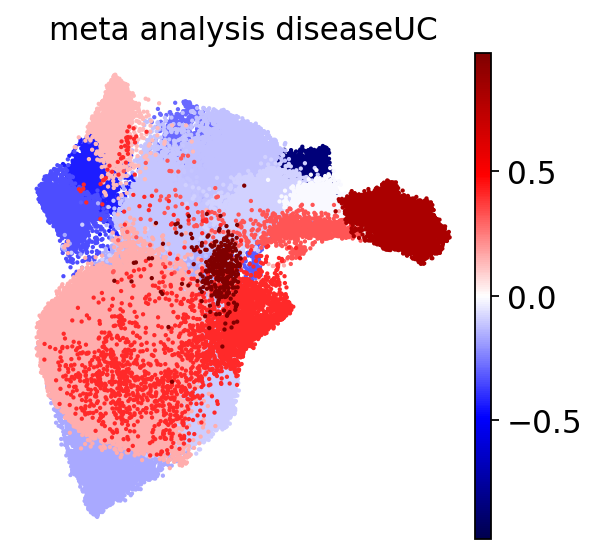

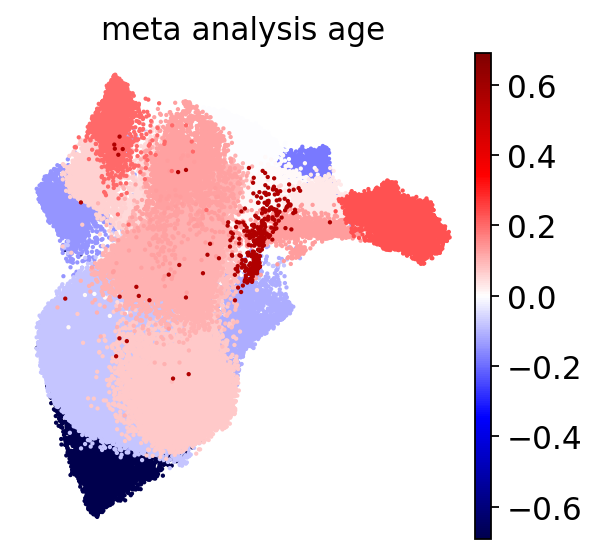

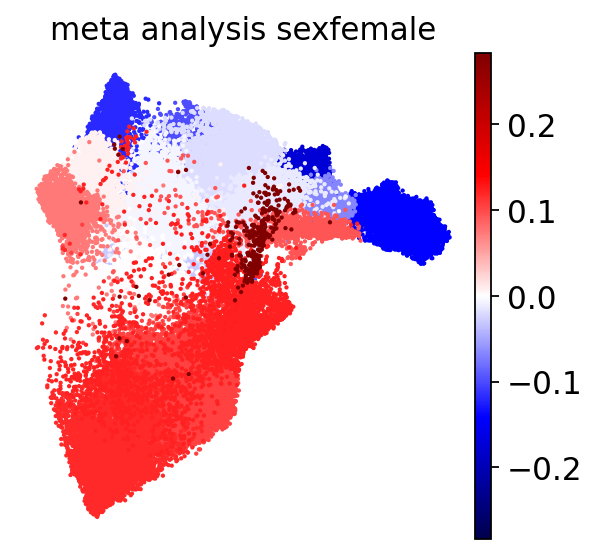

In [44]:
for trait_meta in [x for x in df_metaanalysis['var'].unique() if x.startswith('disease')] + ['age', 'sexfemale']:
    d = df_metaanalysis[df_metaanalysis['var'] == trait_meta]
    adata.obs['meta_analysis'] = 0
    for pos, row in d.iterrows():
        adata.obs.loc[adata.obs['cluster_L2_chr'] == row['cell'], 'meta_analysis'] = row['Estimate']

    sc.pl.umap(adata, color=['meta_analysis'], cmap='seismic', 
               vmin=max(-2,-adata.obs['meta_analysis'].abs().max()), 
               vmax=min(2,adata.obs['meta_analysis'].abs().max()),s=15,
              save='meta_{}'.format(trait_meta), title='meta analysis {}'.format(trait_meta))

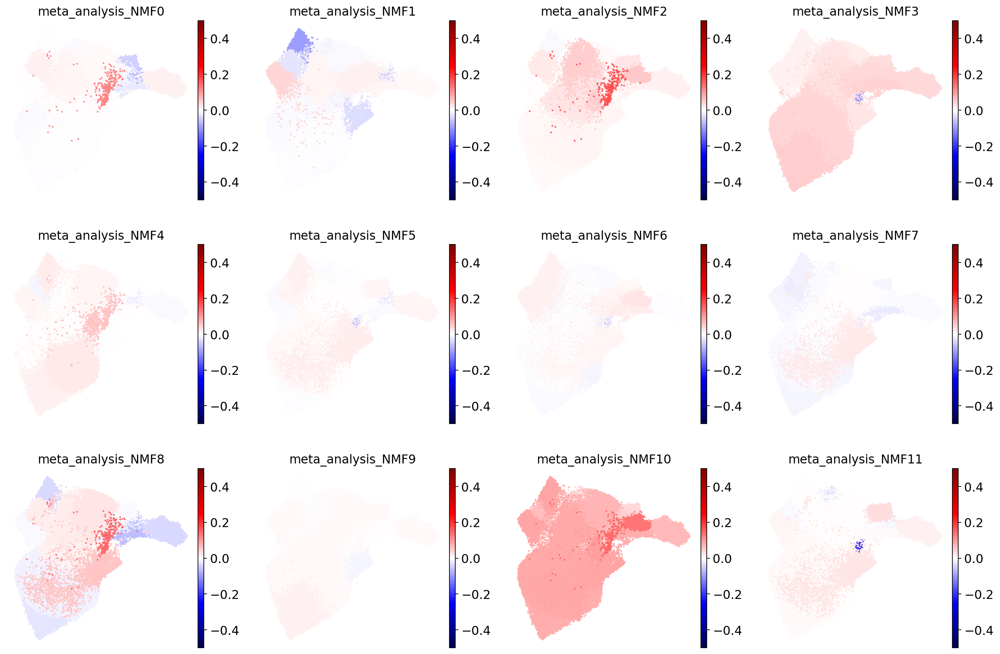

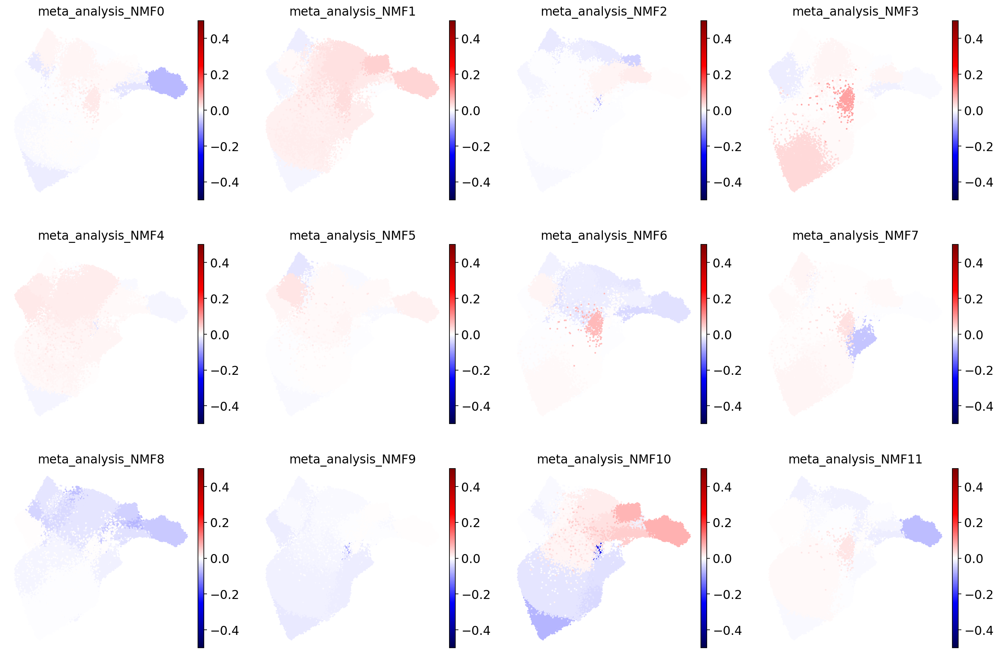

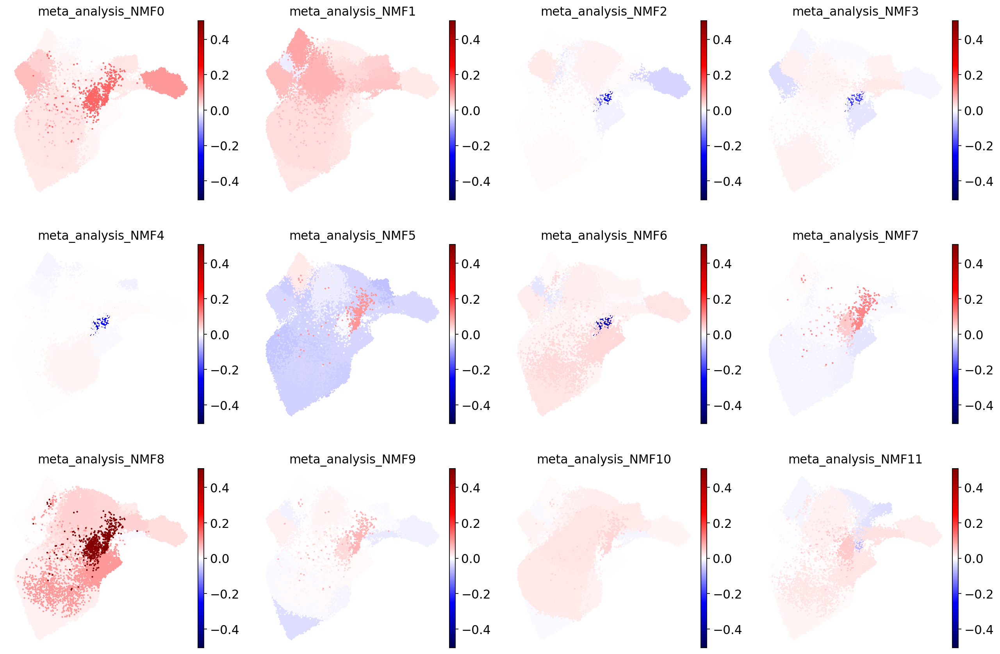

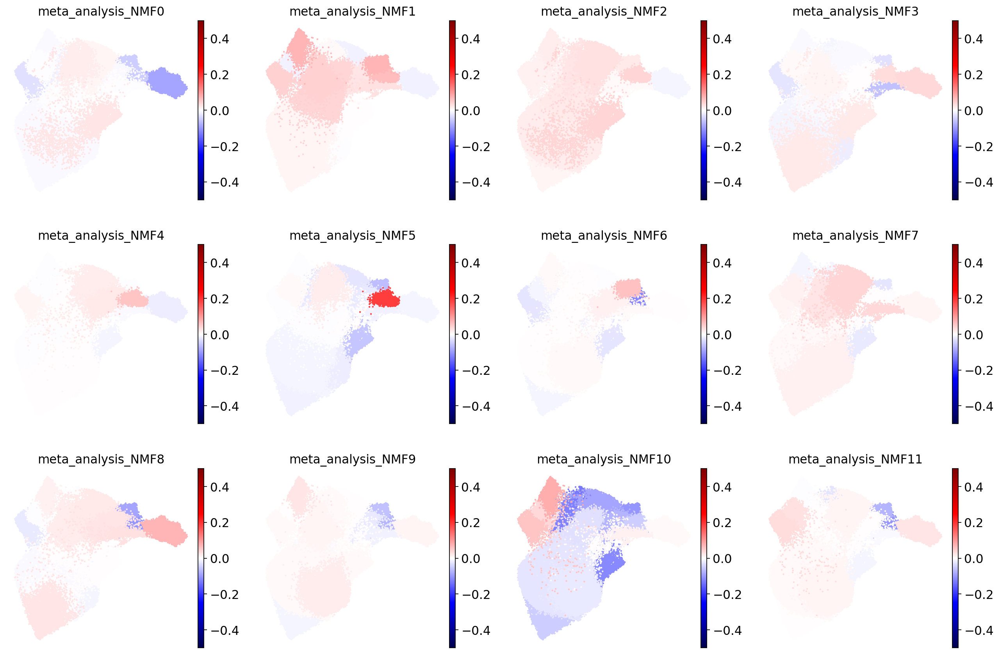

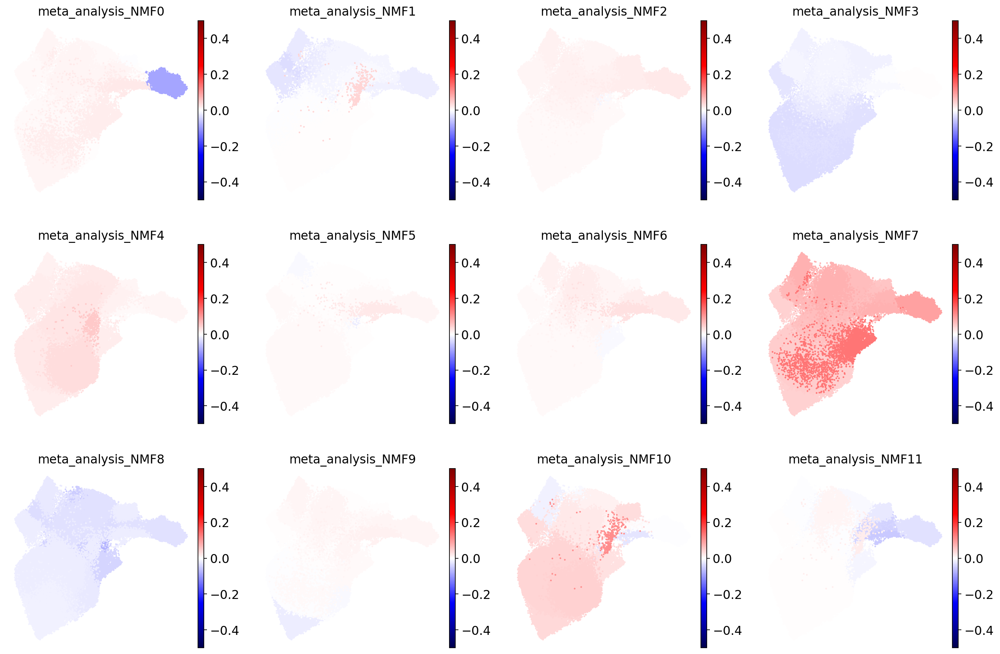

...

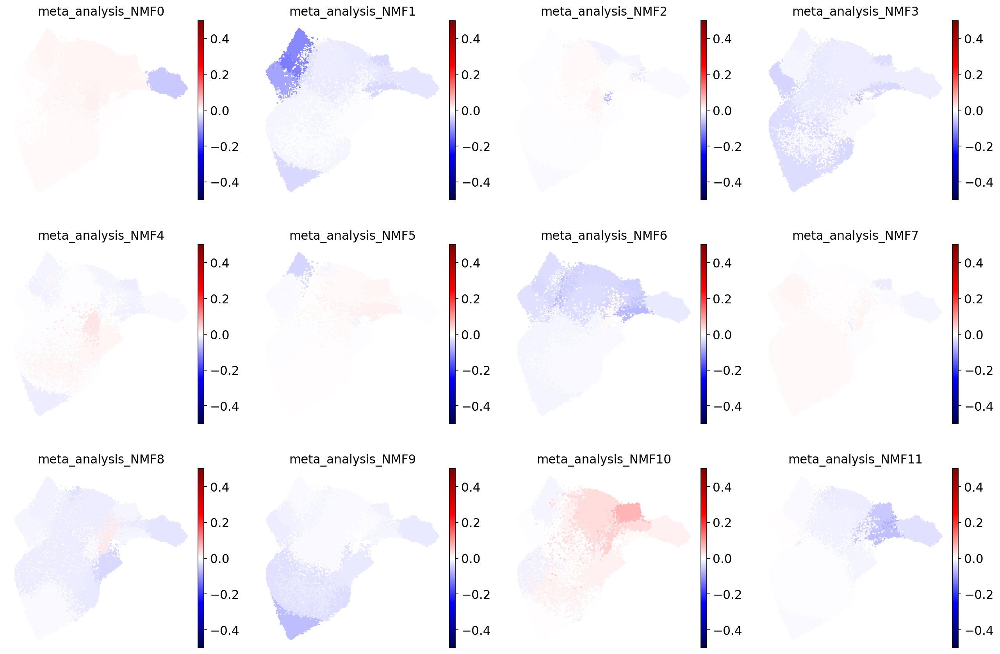

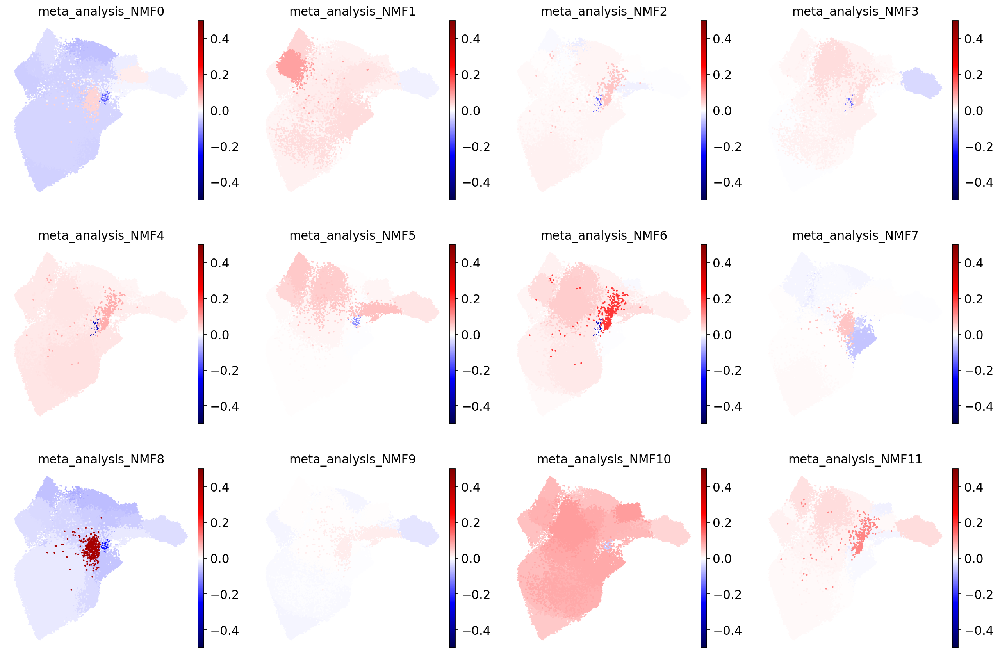

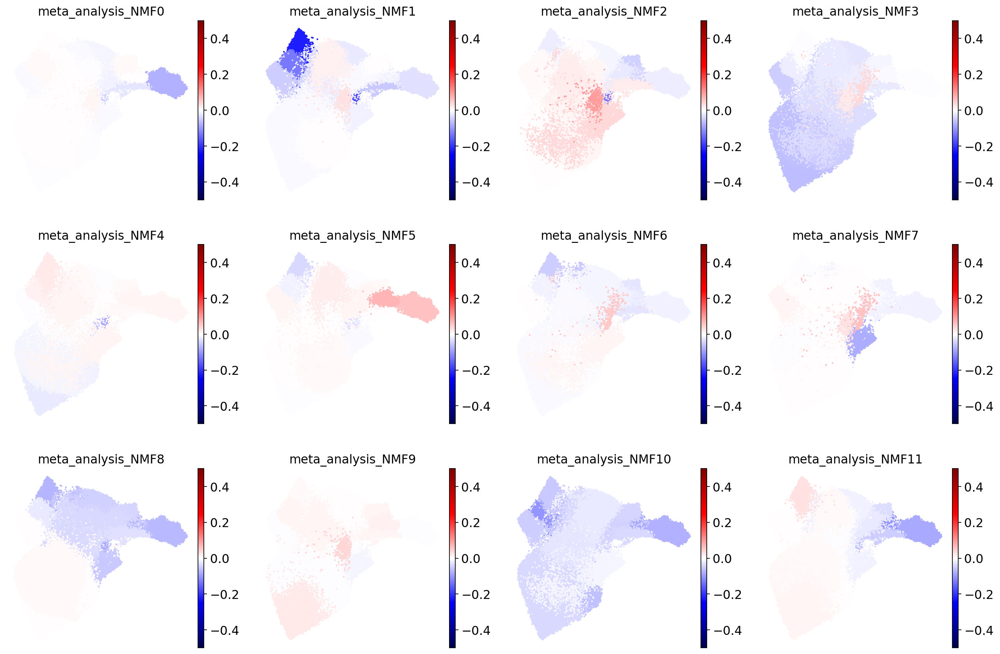

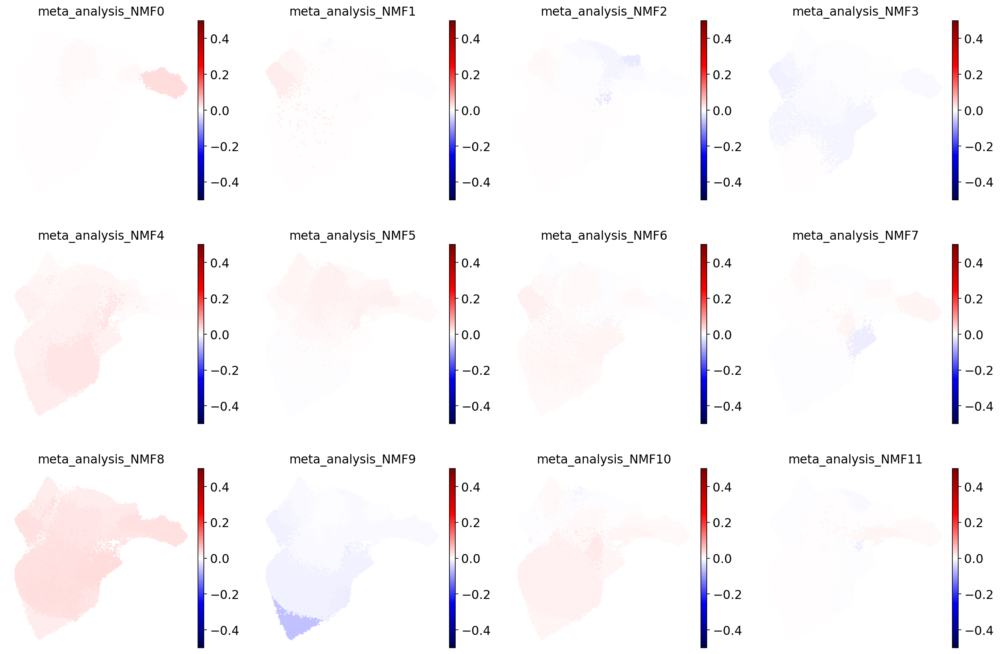

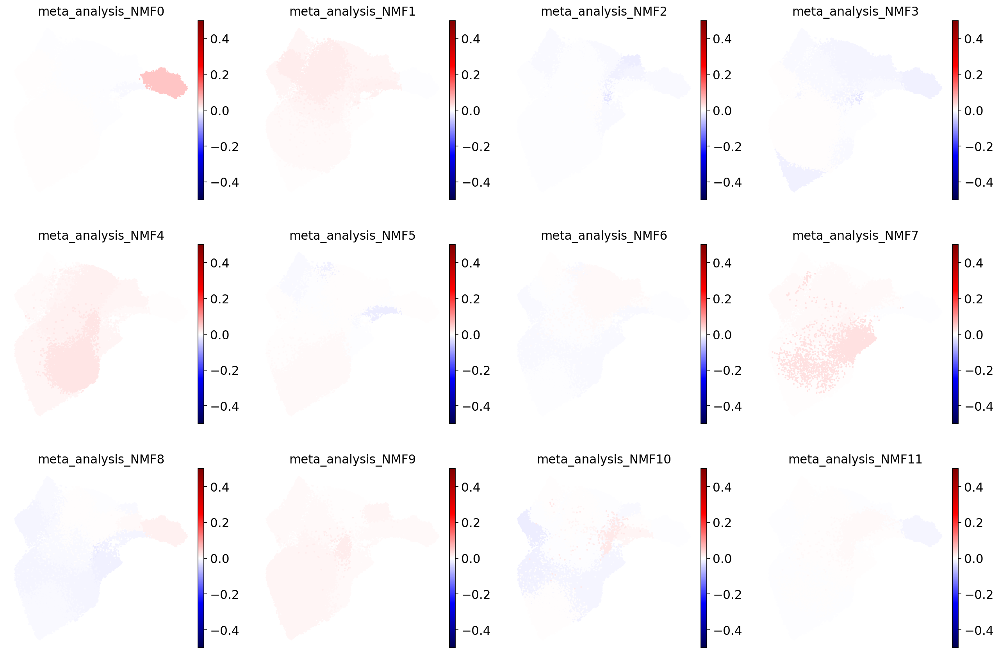

In [45]:
for trait_meta in [x for x in df_metaanalysis['var'].unique() if x.startswith('disease')] + ['age', 'sexfemale']:
    d = df_metaanalysis_nmf[df_metaanalysis_nmf['var'] == trait_meta]

    for i in range(n_comp):
        _d = d[d['component'] == 'NMF_{}'.format(i)]
        adata.obs['meta_analysis_NMF{}'.format(i)] = 0
        for pos, row in _d.iterrows():
            adata.obs.loc[adata.obs['cluster_L2_chr'] == row['cell'], 'meta_analysis_NMF{}'.format(i)] = row['Estimate']

    m = adata.obs[['meta_analysis_NMF{}'.format(i) for i in range(n_comp)]].abs().max().max()
    m = max(0.5, m)
    sc.pl.umap(adata, color=['meta_analysis_NMF{}'.format(i) for i in range(n_comp)], vmax=-m, vmin=m, cmap='seismic',s=15,
              save='meta_nmf_{}'.format(trait_meta))